# TP d'OCVX2 : démélange spectral avec contraintes

La problématique du démélange spectral a été abordée dans un cas restreint et simplifié lors du 2$^{\text{ème}}$ TP d'OCVX1 au S8, faute du bagage théorique nécessaire pour le résoudre dans son contexte le plus général. Ce bagage théorique maintenant acquis, il est temps de se repencher sur la question.

Mais auparavant, rappelons un peu le contexte...

## Un peu de contexte

Une <b> image hyperspectrale </b> est une image composée d'un très grand nombre $N_\text{bandes}$ de canaux (typquement plusieurs dizaines ou centaines) contrairement à une image RGB qui n'en contient que 3. Chaque canal de l'image hyperspectrale correspond à une longueur d'onde précise du spectre électromagnétique. Ainsi, pour une position pixel donnée, l'information enregistrée n'est plus un triplet $(R,G,B)$ comme pour une image RGB standard, mais un $N_\text{bandes}$-uplet $\mathbf{x} = (x_1,\dots,x_{N_\text{bandes}})$ appelé <i> spectre de réflectance </i> du pixel. Ce spectre représente la manère dont la lumière incidente a interragit avec le sol avant d'atteindre le capteur de l'imageur. Deux matériaux (par exemple, du béton et de la végétation) ne réflechissant pas la lumière de la même manière, les images hyperspectrales permettent donc de discriminer les éléments présents dans une scène (dans le cas d'une image prise par satellite, ces consitutants macroscopiques sont par exemple la végétation, la terre, le béton, le bitume, l'eau, etc...)

<img src="figs/HSI_cube.jpg" width=750 />

Mais (car oui, il y a un mais), les images possède une résolution spatiale limitée. En particulier pour celles prises par satellite, elle est de l'ordre de quelques mètres (pour les satellites d'observation terrestres) à quelques dizaines voire centaines de mètres (pour les imageurs des sondes spatiales par exemple). Concrètement, il n'est pas rare (d'ailleurs, il est même fréquent) que plusieurs de ces constituants macroscopiques se "chevauchent" sur la zone couverte par un pixel. Le spectre enregistré pour le pixel est donc un mélange des réponses spectrales de ces constituants macroscopiques purs (appelés <b> pôles de mélange </b> ou <b> endmembers </b> en anglais). Bien que ce mélange puisse être arbitrairement compliqué, l'hypothèse de mélange linaire (appelée <b> LMM </b> pour <i> linear mixing model </i>) est souvent adoptée

<img src="figs/linear_mixing_model.png" width=750 />

Plus formellement, supposons que l'image possède un total de $m$ endmembers dont les spectres sont notés $\mathbf{e}_1,\dots,\mathbf{e}_m$ avec $\mathbf{e}_i \in \mathbb{R}^{N_{bands}}$, alors le LMM implique que le spectre d'un pixel $\mathbf{x}$ se décompose sous la forme d'une combinaison linéaire des $m$ endmembers pondérés en fonction de la prépondérance de l'endmember dans le spectre de $\mathbf{x}$
$$ \mathbf{x} = \sum_{i=1}^m \phi_i \mathbf{e}_i + \boldsymbol \eta\quad (1)$$


Dans l'équation $(1)$, les coefficients de pondération $\phi_1,\dots,\phi_m$ associés aux $m$ endmembers pour le pixel $\mathbf{x}$ sont appelés <b> abondances fractionnelles </b>. Ces abondances fractionnelles varient d'un pixel à l'autre en fonction de sa composition. $\boldsymbol \eta$ correspond à un bruit en général supposé gaussien (parce que bon, quand on sait pas quel modèle coller au bruit, la gaussienne fait toujours plus ou moins l'affaire...) pour rendre compte de l'imprécision du LMM.


En écrivant les $m$ signatures des endmembers sous la forme d'une matrice $\mathbf{E} = [\mathbf{e}_1,\dots,\mathbf{e}_m] \in \mathbb{R}^{N_{bands} \times m}$ et les $m$ abondances fractionnelles associées sous la forme d'un vecteur $\boldsymbol \phi = [\phi_1,\dots,\phi_m] \in \mathbb{R}^m$, l'équation $(1)$ s'écrit sous la forme d'un produit matrice/vecteur 

$$ \mathbf{x} = \mathbf{E} \boldsymbol \phi + \eta \quad (2)$$

L'opération de démélange spectral correspond à inverser ce modèle pour chaque pixel, à savoir retrouver le vecteur $\boldsymbol \phi$ qui minimise la _residual sum of squares_ $RSS(\boldsymbol \phi) = \|\mathbf{x} -  \mathbf{E}\boldsymbol \phi \|_2^2 = (\mathbf{x} -  \mathbf{E}\boldsymbol \phi)^T(\mathbf{x} -  \mathbf{E}\boldsymbol \phi)$ étant donné la matrice d'endmembers $\mathbf{E}$ (aussi appelée matrice de mélange) et le spectre $\mathbf{x}$ du pxiel en question.

$$ \boldsymbol \phi = \arg\min_{\boldsymbol \phi \in \mathbb{R}^m} = \|\mathbf{x} -  \mathbf{E}\boldsymbol \phi \|_2^2 \quad (3)$$

Mais (oui, car il y a encore un mais), l'équation (3) ne prend pas en compte la nature physique des abondances fractionnelles (qui est en fait absolument cruciale). En effet, ces abondances fractionnelles correspondent à des <b> proportions </b>. On attend donc d'elles qu'elles soient <b> positives </b> (un pixel <u> ne peut pas</u> contenir $-15\%$ de végétation) et que <b> leur somme soit de $1$</b> pour chaque pixel (un pixel <u> ne peut pas</u> contenir $50\%$ de végétation et $35\%$ de bitume ... et c'est tout)


Il faut donc compléter l'équation (3) par des contraintes sur $\boldsymbol \phi$ :

* une contrainte de positivité : $\phi_{i}\geq0~\forall i=1,\ldots,m \quad $ (aussi appelée ANC pour <i> abundance nonnegativity constraint</i>)
* une contrainte de somme à 1 : $\sum_{i=1}^{m}\phi_{i}= \mathbf{1}_m^T \boldsymbol \phi= 1 \quad $ (aussi appelée ASC pour <i> abundance sum-to-one constraint</i>) 

Armés de ces deux contraintes, le problème d'estimation des abondances fractionnelles d'un pixel $\mathbf{x}$ se réécrit

$$\arg\min_{\substack{\boldsymbol \phi \in \mathbb{R}^m\\[2pt] \phi_i \geq 0 \, \, \forall i=1,\dots,m \\[2pt] \mathbf{1}_m^T \boldsymbol \phi= 1}} \| \mathbf{x} - \mathbf{E} \boldsymbol \phi\|_2^2 \quad (4)
$$

C'est ce problème précis qu'on se propose de résoudre dans ce TP. On (enfin, vous qui bossez) va suivre la même démarche que dans le TP 2 d'OCVX1 qui s'était attelé à résoudre la version sans contrainte donnée par l'équation (3). Commençons donc par rappeler les principaux résultats du TP 2 d'OCVX1

## Rappels des principaux résultats du TP 2 d'OCVX1

### Chargement des données

<i>Cette partie est identique à l'introduction du TP 2 d'OCVX1</i>

In [1]:
# Les imports de base
import numpy as np
import matplotlib.pyplot as plt
from mpl_toolkits.axes_grid1 import make_axes_locatable
import scipy as sp
from scipy import spatial, optimize
import skimage
from skimage import exposure

On commence par importer les données (hsi $=$ _hyperspectral image_), et une vérité terrain (_gt $=$ ground truth_) normalement utilisée pour de la classification (mais elle va nous permettre de générer la matrice d'endmembers $\mathbf{E}$ à moindres frais).

Les données sont de suite normalisées entre 0 et 1 (correspondant à peu près à une conversion radiance $\Rightarrow$ réflectance).

In [2]:
hsi = np.load('data/pavia.npy')
gt = np.load('data/groundtruth.npy')
hsi = hsi/hsi.max() # conversion de la réflectance en radiance
Nrow,Ncol,Nbands = hsi.shape # sera utile plus tard pour les conversions tenseur 3D/matrice
Npix = Nrow*Ncol
print(hsi.shape)

(610, 340, 103)


On vérifie tout de suite les dimensions de l'image : $610$ lignes, $340$ colonnes et $103$ bandes spectrales.


Quelques infos : la scène a été acquise au dessus de l'université de Pavie, en Italie, par le capteur ROSIS 03 (_Reflective Optics System Imaging Spectrometer_). La résolution spatiale du capteur est de $2.6$ m (autrement dit, un pixel couvre une zone de $2.6 \times 2.6$ m au sol). Les $103$ bandes spectrales s'étalent de $430$ nm à $860$ nm, avec une largeur de bande de $4.0$ nm.

Pour visualiser cette image, il va tout d'abord falloir en extraire une image RGB, donc sélectionner un canal de rouge, un canal de vert et un canal de bleu parmi les $103$ bandes spectrales. Pour les images issues du capteur ROSIS 03, et donc ce jeu de données, on utilise en général $R = 47$, $G = 26$ et $B = 10$.

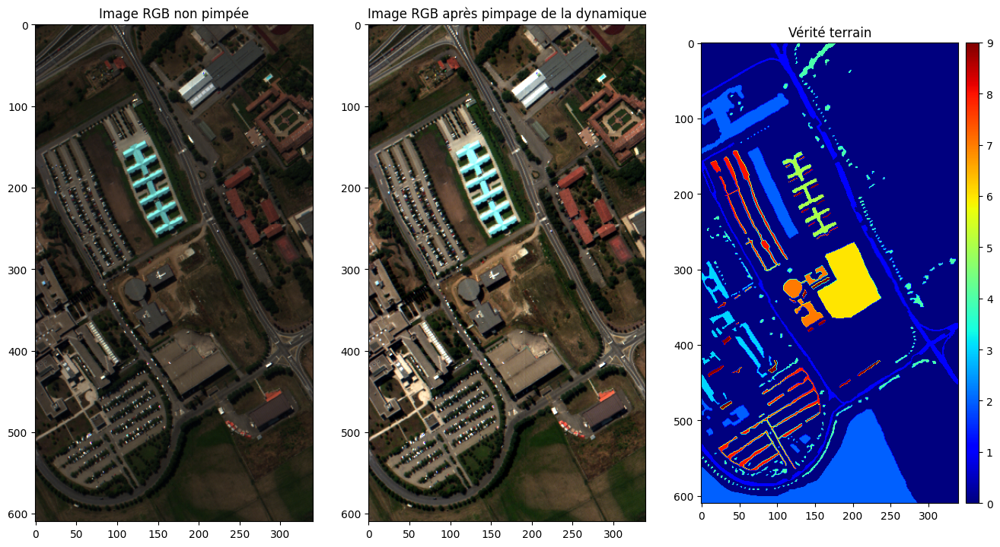

In [3]:
# Par convention, les bandes RGB de cette image sont R=47, G=26 et B=10
hsi_rgb = hsi[:,:,[47,26,10]]

# Réétalonne la dynamique de l'histogramme de chaque bande RGB (étire l'histogramme comprit entre 1% et 99%)
perc = 1
plow, phigh = np.percentile(hsi_rgb, (perc, 100-perc))
pimp_my_hsi_rgb = exposure.rescale_intensity(hsi_rgb, in_range=(plow, phigh))

# Affiche tout ce bazar
plt.figure(figsize=(16,16))
plt.subplot(131)
plt.title('Image RGB non pimpée')
plt.imshow(hsi_rgb)
plt.subplot(132)
plt.imshow(pimp_my_hsi_rgb)
plt.title('Image RGB après pimpage de la dynamique')
plt.subplot(133)
ax = plt.gca()
plt.title('Vérité terrain')
imgt = ax.imshow(gt,cmap='jet')
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="5%", pad=0.1)
plt.colorbar(imgt, cax=cax)
plt.show()

Pour la vérité terrain ci-dessus, chacune des $9$ classes présentent dans l'image est identifiée par un numéro (label) allant de $1$ à $9$ (la classe $0$ étant, par convention, le fond de l'image). La correspondance des labels avec leur classe sémantique est donné ci-dessous

| label | classe |
|  ---  |   ---  | 
| 1 | Asphalte |
| 2 | Champ/herbe |
| 3 | Gravier |
| 4 | Végétation |
| 5 | Plaques de métal peintes |
| 6 | Sol nu|
| 7 | Bitume |
| 8 | Briques autobloquantes |
| 9 | Ombre |

Plutôt que d'utiliser un algorithme d'induction aveugle d'endmembers ou une bibliothèque spectrale, on se sert de la vérité terrain pour construire la matrice d'endmembers $\mathbf{E}$.

On va cependant exclure la classe "ombre", qui ne peut pas être considéré comme un constituant macroscopique pur. Pour les classes de $1$ à $8$, on définit la signature spectrale de l'endmember correspondant comme étant le médoïde de tous les pixels appartenant à la classe, en se servant de l'[implémentation](https://stackoverflow.com/questions/30299267/geometric-median-of-multidimensional-points) de l'algorithme de calcul du médoïde d'un ensemble de points (décrite dans ce [papier](https://www.pnas.org/doi/pdf/10.1073/pnas.97.4.1423)) ci-dessous.

In [4]:
# vecteur médoïde xmed de X [Nsamples,Nfeatures]
def geometric_median(X, eps=1e-5):
    y = np.mean(X, 0)

    while True:
        D = sp.spatial.distance.cdist(X, [y])
        nonzeros = (D != 0)[:, 0]

        Dinv = 1 / D[nonzeros]
        Dinvs = np.sum(Dinv)
        W = Dinv / Dinvs
        T = np.sum(W * X[nonzeros], 0)

        num_zeros = len(X) - np.sum(nonzeros)
        if num_zeros == 0:
            y1 = T
        elif num_zeros == len(X):
            return y
        else:
            R = (T - y) * Dinvs
            r = np.linalg.norm(R)
            rinv = 0 if r == 0 else num_zeros/r
            y1 = max(0, 1-rinv)*T + min(1, rinv)*y

        if sp.spatial.distance.euclidean(y, y1) < eps:
            return y1

        y = y1

On peut donc constituer la matrice d'endmembers $\mathbf{E} \in \mathbb{R}^{N_{bands} \times m}$, en récupérant le médoïde de chacune des $m=8$ premières classes de la vérité terrain. $N_{bands}$ étant évidemment le nombre de bandes dans l'image hyperspectrale

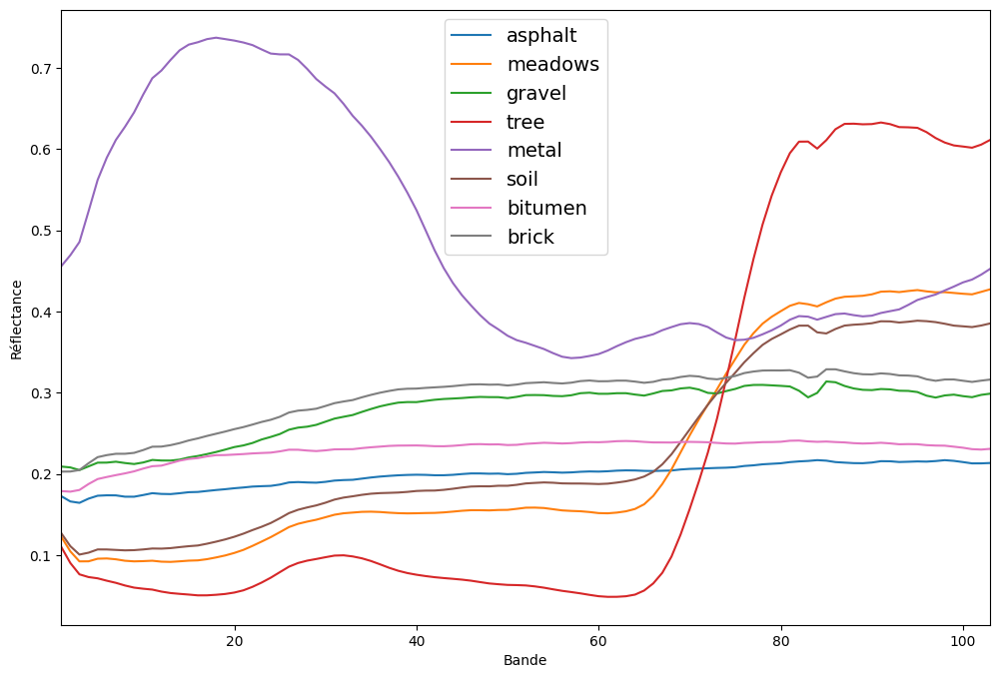

In [5]:
# liste des noms des constituants macroscopiques
endmembers = ['asphalt','meadows','gravel','tree','metal','soil','bitumen','brick']
m = len(endmembers) # m => nombre total d'endmembers considérés
E = np.zeros((Nbands,m)) # E => matrice Nbands x m
hsir = hsi.reshape(Npix,Nbands) # vectorisation du cube 3D (Nrow x Ncol x Nbands) en matrice (Npix x Nbands)
# extraction du médoïde pour chaque classe
for c in range(1,m+1): # indice des classes commençant à 1
    class_idx = (gt==c).ravel() # indices vectorisé des pixels appartenant à la classe c
    all_spectra = hsir[class_idx,:] # récupération des spectres correspondants (lignes de la matrice hsir)
    E[:,c-1] = geometric_median(all_spectra) # calcul du médoïde et stockage dans E
    
# On affice les signatures spectrales des 8 endmembers
plt.figure(figsize=(12,8))
for idx,em in enumerate(endmembers):
    plt.plot(np.arange(1,104),E[:,idx],label=em)
plt.xlim((1,103))
plt.xlabel('Bande')
plt.ylabel('Réflectance')
plt.legend(loc='best',fontsize=14)
plt.show()

On vérifie que la matrice des endmembers $\mathbf{E}$ est donc bien de dimensions $N_{bands}\times m = 103\times 8$

In [6]:
E.shape

(103, 8)

### Démélange par moindres carrés ordinaires (MCO)

La résolution de l'équation $ \boldsymbol \phi = \arg\min_{\boldsymbol \phi \in \mathbb{R}^m} = \|\mathbf{x} -  \mathbf{E}\boldsymbol \phi \|_2^2 \ \ (3)$ se fait par la méthode classique des moindres carrés :
* La fonction objective à minimiser est $J(\boldsymbol \phi) = \|\mathbf{x} -  \mathbf{E}\boldsymbol \phi \|_2^2 = (\mathbf{x} -  \mathbf{E}\boldsymbol \phi)^T(\mathbf{x} -  \mathbf{E}\boldsymbol \phi)$
* Le calcul du gradient $\nabla J(\boldsymbol \phi)$ (via le calcul de la différentielle $d_{\boldsymbol \phi} J$) donne $\nabla J(\boldsymbol \phi) = 2 \mathbf{E}^T(\mathbf{E}\boldsymbol \phi - \mathbf{x})$
* L'annulation du gradient précédent donne finalement la solution classique des moindres carrés comme solution de (3) : $\hat{\boldsymbol \phi} = (\mathbf{E}^T \mathbf{E})^{-1} \mathbf{E}^T \mathbf{x}$

In [7]:
# Moindre carrés à la main
LSU = lambda E,x : np.linalg.inv(E.T @ E) @ (E.T @ x)

Ce solveur réécrit à la main est totalement équivalent à la fonction built-in de scipy `sp.optimize.lsq_linear`

In [8]:
pix_idx = np.random.choice(hsir.shape[0]) # indice d'un pixel choisi aléatoirement
x = hsir[pix_idx,:] # spectre du pixel en question
np.allclose(LSU(E,x),sp.optimize.lsq_linear(E,x)['x']) # comparaison du MCO 'à la main' avec celui de scipy

True

Évidemment, si les abondances fractionnelles $\boldsymbol \phi$ obtenue par la méthode des moindres carrés sont la solution optimale du problème (3), elles ne sont pas interprétables en tant que proporitions puisque les contraintes de positivité et de somme à 1 ne sont pas prises en compte. C'est ce qui nous avait poussé dans le TP 2 d'OCVX1 à aller explorer des techniques de régularisation (Tikhonov et LASSO).

In [9]:
LSU(E,x)

array([-0.95633658, -1.75850937,  1.64936676, -0.00537365,  0.03677434,
        3.60937538,  1.19395258, -2.60949324])

Cependant, il est facile de se convaincre que la solution fournie par les moindres carrés ordinaires est bien celle qui est optimale mathématiquement : il suffit de comparer le spectre $\mathbf{x}$ d'origine avec celui qui est reconstruit via les abondance fractionnelles calculées $\hat{\mathbf{x}} = \mathbf{E}\boldsymbol \phi$

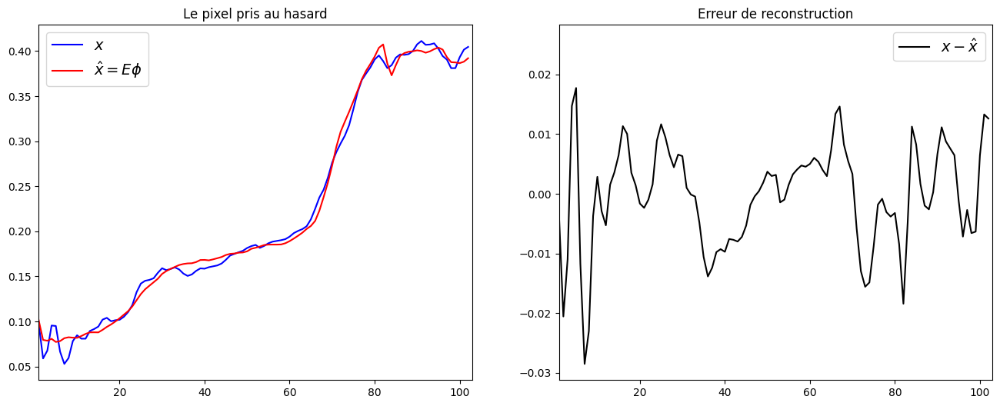

In [10]:
plt.figure(figsize=(16,6))
plt.subplot(121)
plt.plot(x,'b',label=r'$x$')
plt.plot(E @ LSU(E,x),'r',label=r'$\hat{x} = E\phi$')
plt.title('Le pixel pris au hasard')
plt.legend(loc='best',fontsize=14)
plt.xlim((1,103))
plt.subplot(122)
plt.plot(x - E @ LSU(E,x),'k',label=r'$x - \hat{x}$')
plt.title('Erreur de reconstruction')
plt.xlim((1,103))
plt.legend(loc='best',fontsize=14)
plt.show()

Démélanger pixel par pixel, c'est bien. Mais s'il était possible d'obtenir d'un coup les abondances fractionnelles de tous les pixels de l'image, ça serait quand même mieux. Et ça tombe bien, car c'est possible : il suffit d'utiliser la modélisation matricielle de l'image hyperspectrale $\mathbf{X} \in \mathbb{R}^{N_{bands} \times N_{pix}}$ et d'étendre le problème (3) sous la forme 

$$\boldsymbol \Phi = \arg\min_{\Phi \in \mathbb{R}^{m\times N_{pix}}} = \|\mathbf{X} -  \mathbf{E}\Phi \|_2^2 \quad (3\text{bis})$$

La solution $\boldsymbol \Phi \in \mathbb{R}^{m\times N_{pix}}$ obtenue s'interprète donc comme une matrice d'abondances fractionnelles, où chaque colonne contient le vecteur d'abondance $\boldsymbol \phi$ du pixel correspondant. Cette matrice peut se réorganiser à moindres frais en un cube 3D $(N_{row} \times N_{col} \times m)$, où chaque canal peut se visualiser comme la carte d'abondances fractionelles de l'image entière pour l'endmember considéré.

Et contrairement à la fonction de scipy qui ne peut s'appliquer que pixel par pixel, la `lambda` définie précédemment à la main permet d'effectuer ce démélange pour toute l'image hyperspectrale d'un seul coup (modulo une petite manipulation sur la forme de la matrice hyperspectrale en entrée)

In [11]:
LSU(E,hsir.T).shape # besoin de la transposée ici pour que les dimensions concordent

(8, 207400)

In [12]:
Phi_MCO = LSU(E,hsir.T)
Phi_MCO = Phi_MCO.reshape(m,Nrow,Ncol) # reshape en un cube 3D m x Nrow x Ncol
Phi_MCO = np.moveaxis(Phi_MCO,0,-1) # reshape finalement en un cube 3d Nrow x Ncol x m

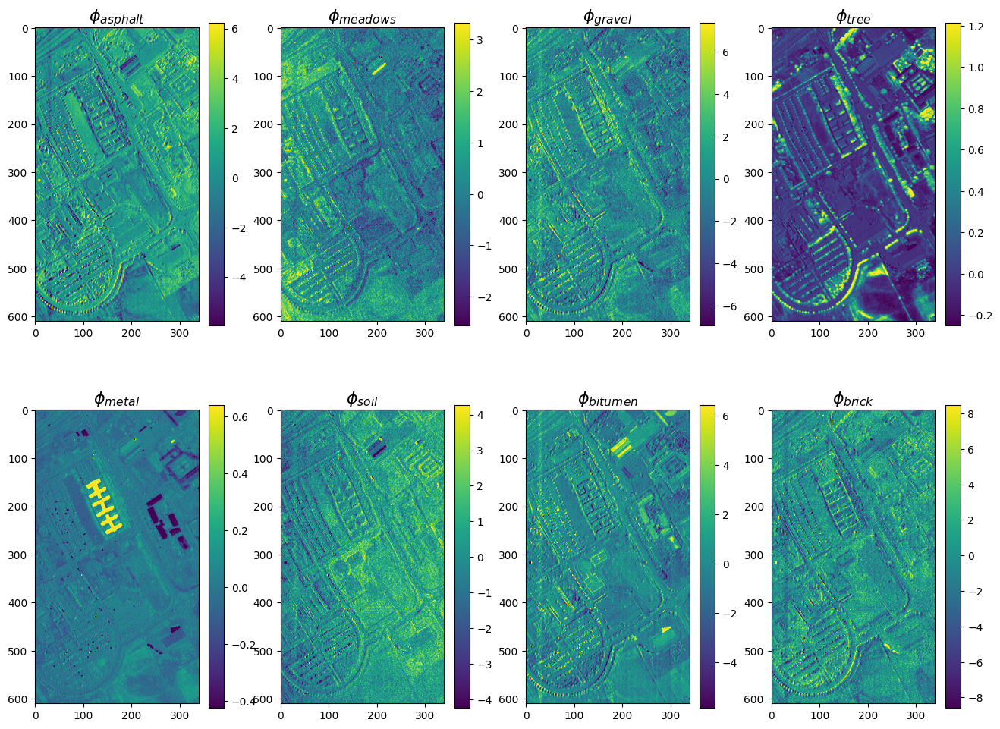

In [13]:
perc=1 # =1 si on veut filtrer un peu, =0 sinon
plow, phigh = np.percentile(Phi_MCO, (perc, 100-perc),axis=(0,1))
plt.figure(figsize=(16,12))
plt.tight_layout()
for i in range(8):
    plt.subplot(2,4,i+1)
    plt.imshow(Phi_MCO[:,:,i], vmin=plow[i], vmax=phigh[i])
    plt.title(r'$\phi_{%s}$'%endmembers[i],fontsize=16)
    plt.colorbar(shrink=0.95)
plt.show()

Dans le TP 2 d'OCVX1, on avait tout d'abord défini une métrique pour évaluer la qualité du démélange pour un pixel $\mathbf{x}$ donné : l'erreur quadratique moyenne entre $\mathbf{x}$ et sa reconstruction $\mathbf{\hat{x}} = \sum_{i=1}^m \phi_i \mathbf{e}_i$ :

$$\epsilon(\mathbf{x},\mathbf{\hat{x}}) = \sqrt{\frac{1}{N_{bands}} \sum_{i=1}^{N_{bands}} (x(i) - \hat{x}(i))^2} = \frac{1}{\sqrt{N_{bands}}} \| \mathbf{x} - \mathbf{\hat{x}}\|_2 \quad (5)$$

Tout comme l'équation (3) peut se reformuler pour obtenir une solution matricielle (la matrice $\boldsymbol \Phi$), il est possible d'obtenir d'un coup l'erreur quadratique moyenne de l'image entière $\epsilon(\mathbf{X},\mathbf{\hat{X}} = \mathbf{E}\boldsymbol \Phi)$ (plutôt que de boucler sur tous les pixels).

Le résultat de cette dernière vous est rappelé ci-dessous. Quant à son calcul, à vous de le récupérer dans votre code du TP 2 d'OCVX1 puisqu'il sera nécessaire pour la suite de ce TP

In [14]:
# ON récupère les principaux résultats du TP 2 d'OCVX1 pour le démélange par moindres carrés
LSU_MCO_results = np.load('data/LSU_MCO_results.npy',allow_pickle='TRUE').item() 

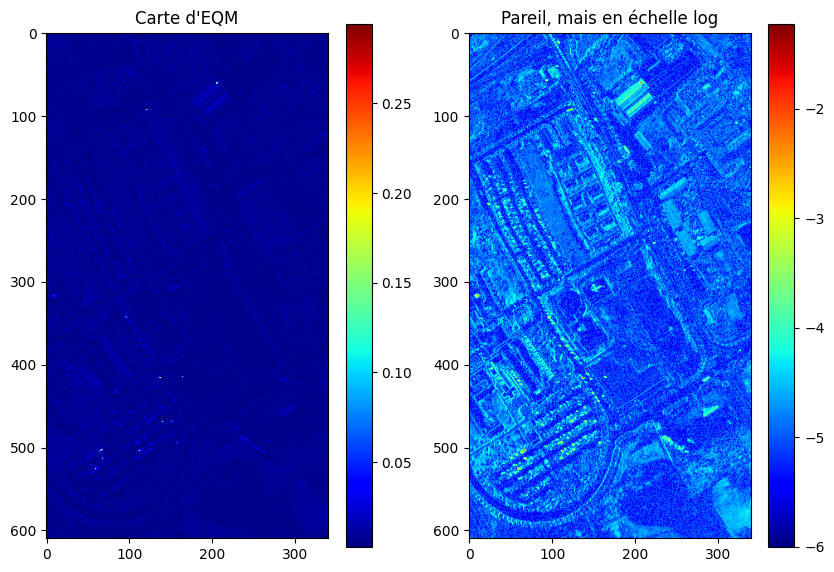

In [15]:
eps_X = LSU_MCO_results["RMSE"]
plt.figure(figsize=(10,8))
plt.subplot(121)
plt.title("Carte d'EQM")
plt.imshow(eps_X,cmap='jet') # en échelle normale, où on ne voit pas grand chose à cause de quelques outliers
plt.colorbar(shrink=0.85)
plt.subplot(122)
plt.title('Pareil, mais en échelle log')
plt.imshow(np.log(eps_X),cmap='jet') # en échelle log, on voit un peu plus la structure spatiale de l'erreur
plt.colorbar(shrink=0.85)
plt.show()

Dans un deuxième temps, on s'était intéressé à une stratégie de classification naïve pour évaluer la pertinence de la solution retournée par les moindres carrés ordinaires : chaque pixel était classifié selon son abondance fractionnelle majoritaire. En effet, en théorie, plus l'abondance fractionnelle est proche de $1$, plus le matériau correspondant est présent dans la signature spectrale du pixel en question. Même si le démélange obtenu précédemment avec les moindres carrés ordinaires laissait penser que cette stratégie est vouée à l'échec, ça ne coûtait pas grand chose d'y jeter un oeil.

En particulier, cette stratégie avait été appliqué pour les pixels de la vérité terrain, qui sont supposés "purs". Par exemple, un pixel de la classe "béton" de la vérité terrain ne devrait être constitué que de béton, donc son abondance fractionnelle majoritaire devrait correspondre à la classe "béton". Les pixels à classifier par cette stratégie sont donc ceux dont le label est compris entre $1$ et $8$ (les pixels labelisés $0$ sont de classe inconnue du point de vue de la classification, et les pixels labelisés $9$ correspondant à de l'ombre, ils ne sont pas purs non plus).

Les résultats qualitatifs et quantitafifs de cette stratégie de classification sont rappelés ci-dessous. Quant au code permettant la classification et son évaluation, à vous de le récupérer dans votre TP 2 d'OCVX1, puisque nous allons suivre la même stratégie de validation dans la suite de ce TP.

In [16]:
import sklearn
from sklearn import metrics

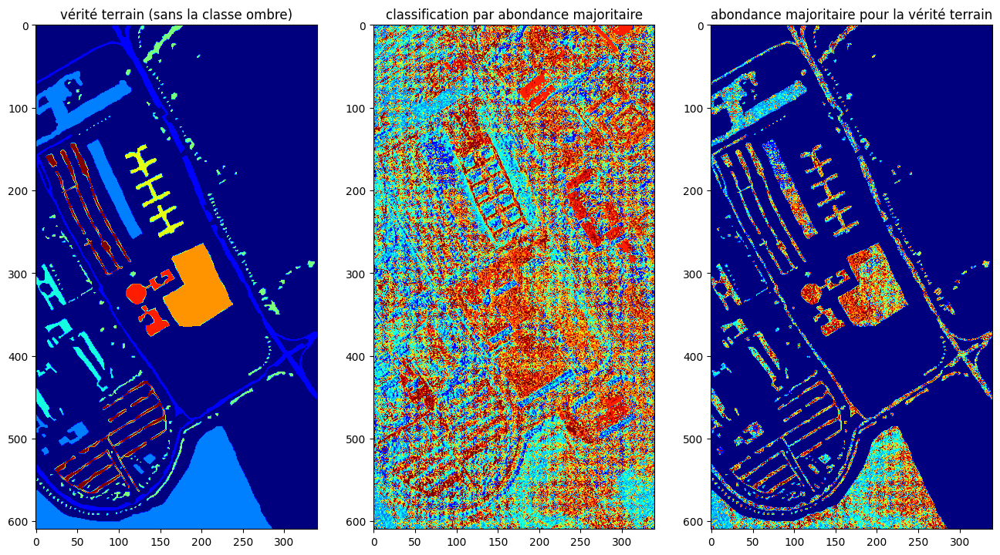

In [17]:
argmaxPhi_MCO = LSU_MCO_results["classif_full"]
argmaxPhi_MCO_mask = LSU_MCO_results["classif_filtered"]

plt.figure(figsize=(16,12))
plt.subplot(131)
plt.title('vérité terrain (sans la classe ombre)')
plt.imshow(gt*(gt<9),cmap='jet',vmin=0,vmax=8)
plt.subplot(132)
plt.title('classification par abondance majoritaire')
plt.imshow(argmaxPhi_MCO,cmap='jet',vmin=0,vmax=8)
plt.subplot(133)
plt.title('abondance majoritaire pour la vérité terrain')
plt.imshow(argmaxPhi_MCO_mask,cmap='jet',vmin=0,vmax=8)
plt.show()

In [18]:
# Taux de bonne classification globale
OA_MCO = LSU_MCO_results["overall_acc"] 
print('Taux de bonne classification globale : %1.2f%%'%(100*OA_MCO).astype(float))

Taux de bonne classification globale : 28.50%


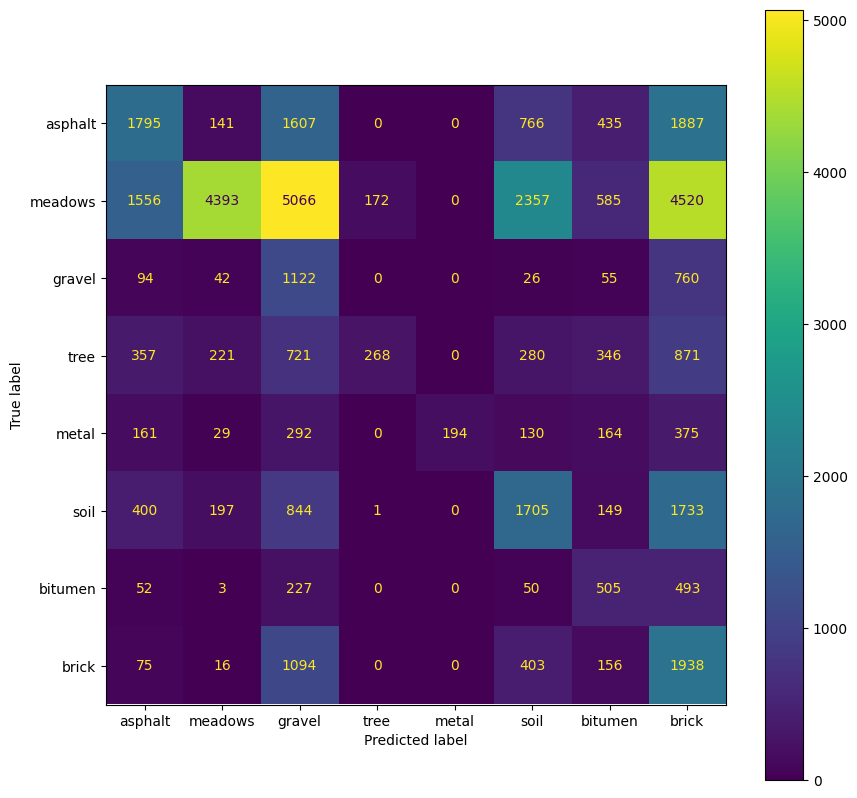

In [19]:
# Matrice de confusion
CM_MCO = LSU_MCO_results["confusion_matrix"]
CMplot_MCO = sklearn.metrics.ConfusionMatrixDisplay(CM_MCO,display_labels=endmembers)
fig,ax = plt.subplots(figsize=(10,10))
CMplot_MCO.plot(ax=ax)
plt.show()

In [20]:
# Classification par classe
CA_MCO = CM_MCO.diagonal()/CM_MCO.sum(axis=1)
for i,c in enumerate(endmembers):
    print('Taux de bonne classification pour la classe %s : %1.3f%%'%(c,100*CA_MCO[i]))

Taux de bonne classification pour la classe asphalt : 27.070%
Taux de bonne classification pour la classe meadows : 23.556%
Taux de bonne classification pour la classe gravel : 53.454%
Taux de bonne classification pour la classe tree : 8.747%
Taux de bonne classification pour la classe metal : 14.424%
Taux de bonne classification pour la classe soil : 33.903%
Taux de bonne classification pour la classe bitumen : 37.970%
Taux de bonne classification pour la classe brick : 52.634%


## I. Démélange avec contrainte de somme à 1

On attaque maintenant le coeur de ce TP : le démélange spectral en prenant en compte les contraintes sur les abondances !

Dans un premier temps, on ne va considérer que la contrainte de somme à 1 des abondances, pour la simple et bonne raison que le problème d'optimisation sous contrainte admet une solution analytique que l'on peut calculer via la résolution des conditions de Karush-Kuhn-Tucker (KKT).

Ainsi, dans cette partie, on va se pencher sur la résolution du problème suivant :

$$\arg\min_{\substack{\boldsymbol \phi \in \mathbb{R}^m\\[2pt] \mathbf{1}_m^T \boldsymbol \phi= 1}} \| \mathbf{x} - \mathbf{E} \boldsymbol \phi\|_2^2 \quad (6)
$$

La contrainte $\mathbf{1}_m^T \boldsymbol \phi = \sum_{i=1}^{m}\phi_{i} = 1$ du problème d'optimisation (6) ci-dessus sera abrégée par ASC (pour <i> abundance sum-to-one constraint</i>) 

### Résolution analytique du problème (6) avec ASC

#### 1.1) Écrivez et résolvez les conditions KKT du problème (6) de démélange avec ASC pour en déduire la solution analytique

La résolution des conditions KKT est un poil calculatoire. Pour vous aider, voici les grandes étapes à suivre :
1) Réécrire la contrainte d'ASC sous une forme standard $h(\boldsymbol \phi) = 0$ <br>
2) Écrire le Lagrangien $\mathcal{L}(\boldsymbol \phi,\lambda)$ de (6) en introduisant un multiplicateur de Lagrange $\lambda$ associé à la contrainte d'égalité <br>
3) Calculer le gradient relativement à $\boldsymbol \phi$ du Lagrangien $\nabla_{\boldsymbol \phi} \mathcal{L}(\boldsymbol \phi,\lambda)$ ⚠️ la variable $\boldsymbol \phi$ est vectorielle, donc attention aux règles de dérivation... <br>
4) Déterminer une relation entre $\lambda$ et $\boldsymbol \phi$ grâce à la condition de stationarité du Lagrangien $\nabla_{\boldsymbol \phi} \mathcal{L}(\boldsymbol \phi,\lambda) = 0$ <br>
5) Injecter la relation précédente dans la contrainte d'égalité pour déterminer la valeur optimale du multiplicateur $\lambda$ <br>
6) Remplacer la valeur de $\lambda$ dans la relation 4) par celle trouvée dans la relation 5) <br>
7) ... <br>
8) profit!

In [21]:
# TODO
m = E.shape[1]
vect_1 = np.ones((m, 1))
ET_E_inv = np.linalg.inv(E.T @ E)
phi_mco = ET_E_inv @ E.T @ x
A = (((vect_1.T @ phi_mco)[0] - 1) / (vect_1.T @ ET_E_inv @ vect_1)[0][0])

phi_asc = phi_mco - A * ET_E_inv @ vect_1.ravel()

phi_asc.shape

(8,)

#### 1.2) Implémentez la solution de (6) et vérifiez sur quelques spectres qu'elle fonctionne qualitativement et quantitativement

* Qualitativement : comparer la forme du spectre $\mathbf{x}$ avec sa version reconstruite en prenant en compte l'ASC $\mathbf{\hat{x}}_{ASC} = \mathbf{E} \hat{\boldsymbol \phi}_{ASC}$ et avec les moindres carrés ordinaires $\mathbf{\hat{x}}_{MCO} = \mathbf{E} \hat{\boldsymbol \phi}_{MCO}$
* Quantitativement : vérifier que la contrainte de somme à 1 pour les abondances frationnelles obtenues est bien vérifiée, et calculer l'erreur quadratique moyenne de reconstruction

Que pouvez-vous en conclure ?

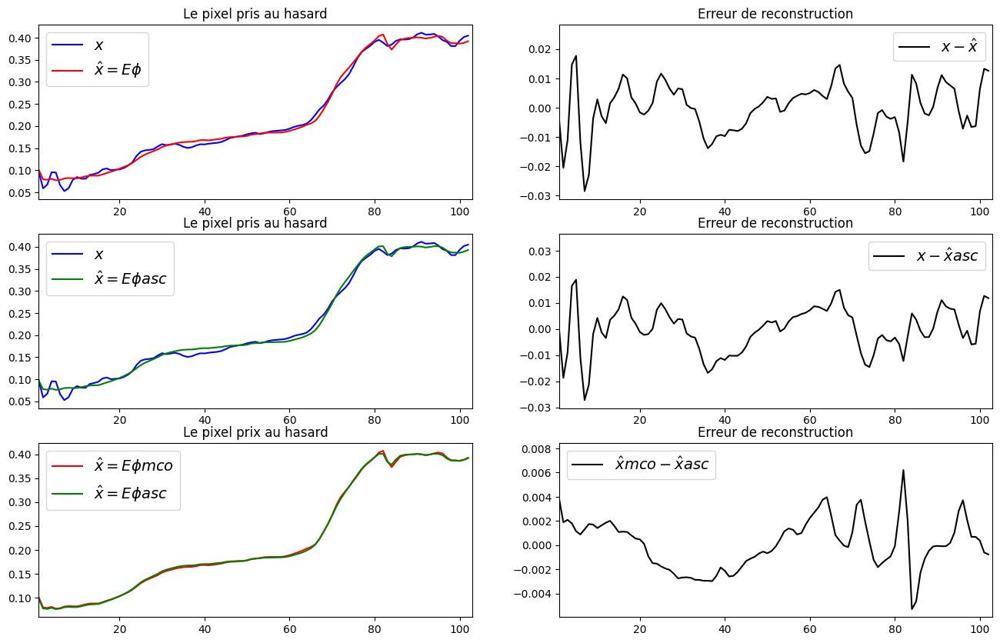

In [22]:
# TODO
plt.figure(figsize=(16,10))

plt.subplot(321)
plt.plot(x,'b',label=r'$x$')
plt.plot(E @ LSU(E,x),'r',label=r'$\hat{x} = E\phi$')
plt.title('Le pixel pris au hasard')
plt.legend(loc='best',fontsize=14)
plt.xlim((1,103))

plt.subplot(322)
plt.plot(x - E @ LSU(E,x),'k',label=r'$x - \hat{x}$')
plt.title('Erreur de reconstruction')
plt.xlim((1,103))
plt.legend(loc='best',fontsize=14)

plt.subplot(323)
plt.plot(x,'b',label=r'$x$')
plt.plot(E @ phi_asc,'g',label=r'$\hat{x} = E\phi{asc}$')
plt.title('Le pixel pris au hasard')
plt.legend(loc='best',fontsize=14)
plt.xlim((1,103))

plt.subplot(324)
plt.plot(x - E @ phi_asc,'k',label=r'$x - \hat{x}asc$')
plt.title('Erreur de reconstruction')
plt.xlim((1,103))
plt.legend(loc='best',fontsize=14)

plt.subplot(325)
plt.plot(E @ LSU(E,x),'r',label=r'$\hat{x} = E\phi{mco}$')
plt.plot(E @ phi_asc,'g',label=r'$\hat{x} = E\phi{asc}$')
plt.title('Le pixel prix au hasard')
plt.legend(loc='best',fontsize=14)
plt.xlim((1,103))

plt.subplot(326)
plt.plot((E @ LSU(E, x)) - (E @ phi_asc),'k',label=r'$\hat{x}mco - \hat{x}asc$')
plt.title('Erreur de reconstruction')
plt.xlim((1,103))
plt.legend(loc='best',fontsize=14)

plt.show()

In [23]:
phi_asc.sum()
# La somme est bien égale à 1

1.0000000000000109

In [24]:
squared_errors_mco = (x - E @ LSU(E, x)) ** 2
rmse_mco = np.sqrt(np.mean(squared_errors_mco))

squared_errors_asc = (x - E @ phi_asc) ** 2
rmse_asc = np.sqrt(np.mean(squared_errors_asc)) # rmse = root_mean_squared_error

rmse_mco, rmse_asc

# On peut en conclure que la solution trouvée par mco est un peu plus précise que celle trouvée par asc, 
# comportement prévisible étant donné que la contrainte rajoute une difficulté supplémentaire 
# pour trouver la solution la plus optimale possible

(0.008897869531782595, 0.009163215006380314)

#### 1.3) Calculez la matrice d'abondances $\boldsymbol \Phi$ pour toute l'image, puis affichez ces cartes d'abondances fractionnelles et la carte d'erreur quadratique moyenne de reconstruction pour l'image entière. Comparez avec les résultats obtenus par MCO

Contrairement à l'approche par MCO qui permettait d'obtenir d'un coup toutes les abondances fractionnelles de l'image entière, le démélange (6) avec ASC ne le permet pas (bien qu'il soit possible de reformuler (6) sous forme matricielle, la résolution des conditions KKT ne donne pas de solution analytique). Pour obtenir les abondances $\boldsymbol \Phi$ pour toute l'image, il faudra donc boucler sur tous les pixels de l'image...

In [25]:
def find_asc(E, x) :
    m = E.shape[1]
    vect_1 = np.ones((m, 1))
    ET_E_inv = np.linalg.inv(E.T @ E)
    phi_mco = ET_E_inv @ E.T @ x
    A = (((vect_1.T @ phi_mco)[0] - 1) / (vect_1.T @ ET_E_inv @ vect_1)[0][0])

    phi_asc = phi_mco - A * ET_E_inv @ vect_1.ravel()

    return phi_asc

In [26]:
# TODO
Phi_MCO = LSU(E, hsir.T)

Phi_MCO = Phi_MCO.reshape(m,Nrow,Ncol) # reshape en un cube 3D m x Nrow x Ncol
Phi_MCO = np.moveaxis(Phi_MCO,0,-1) # reshape finalement en un cube 3d Nrow x Ncol x m

Phi_ASC = []

for i in range(hsir.shape[0]) :
    x_ = hsir[i, :]
    phi_asc_ = find_asc(E, x_)
    Phi_ASC.append(phi_asc_)

Phi_ASC = np.array(Phi_ASC).reshape((Nrow, Ncol, m))

Phi_MCO.shape, Phi_ASC.shape

((610, 340, 8), (610, 340, 8))

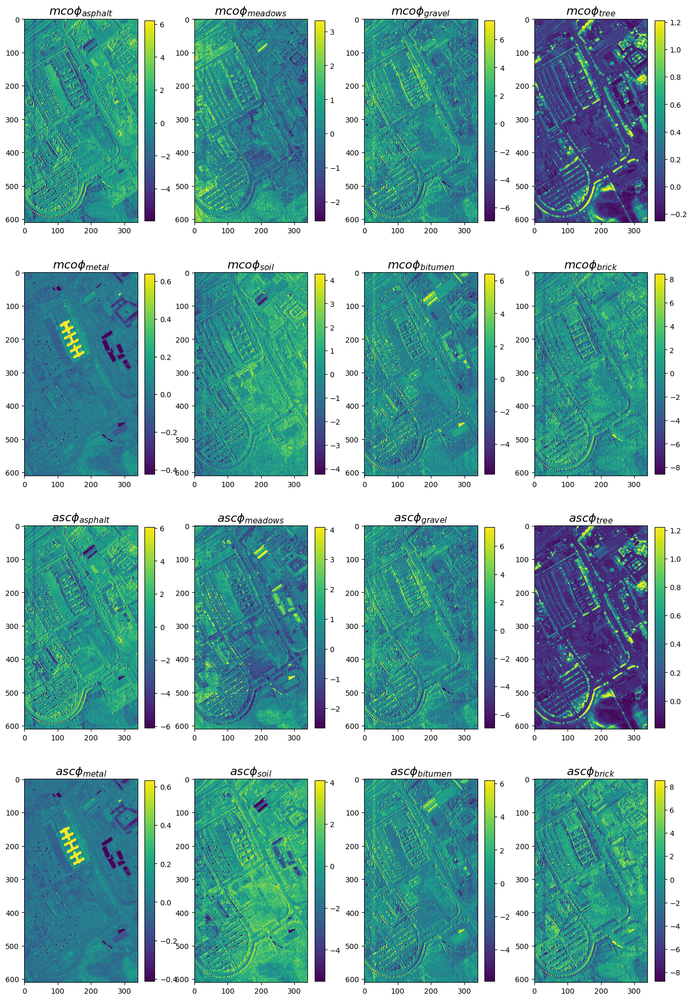

In [27]:
perc=1 # =1 si on veut filtrer un peu, =0 sinon
plow_MCO, phigh_MCO = np.percentile(Phi_MCO, (perc, 100-perc),axis=(0,1))
plow_ASC, phigh_ASC = np.percentile(Phi_ASC, (perc, 100-perc),axis=(0,1))
plt.figure(figsize=(16,24))
plt.tight_layout()
for i in range(16):
    if (i < 8) :
        plt.subplot(4,4,i+1)
        plt.imshow(Phi_MCO[:,:,i], vmin=plow_MCO[i], vmax=phigh_MCO[i])
        plt.title(r'$mco\phi_{%s}$'%endmembers[i],fontsize=16)
        plt.colorbar(shrink=0.95)
    else :
        plt.subplot(4,4,i+1)
        plt.imshow(Phi_ASC[:,:,i - 8], vmin=plow_ASC[i - 8], vmax=phigh_ASC[i - 8])
        plt.title(r'$asc\phi_{%s}$'%endmembers[i - 8],fontsize=16)
        plt.colorbar(shrink=0.95)
plt.show()

In [28]:
eps_X_mco = LSU_MCO_results["RMSE"]

X = Phi_ASC @ E.T
eps_X_asc = np.sqrt(np.mean((hsi - X) ** 2, axis=2))

eps_X_mco.shape, eps_X_asc.shape

((610, 340), (610, 340))

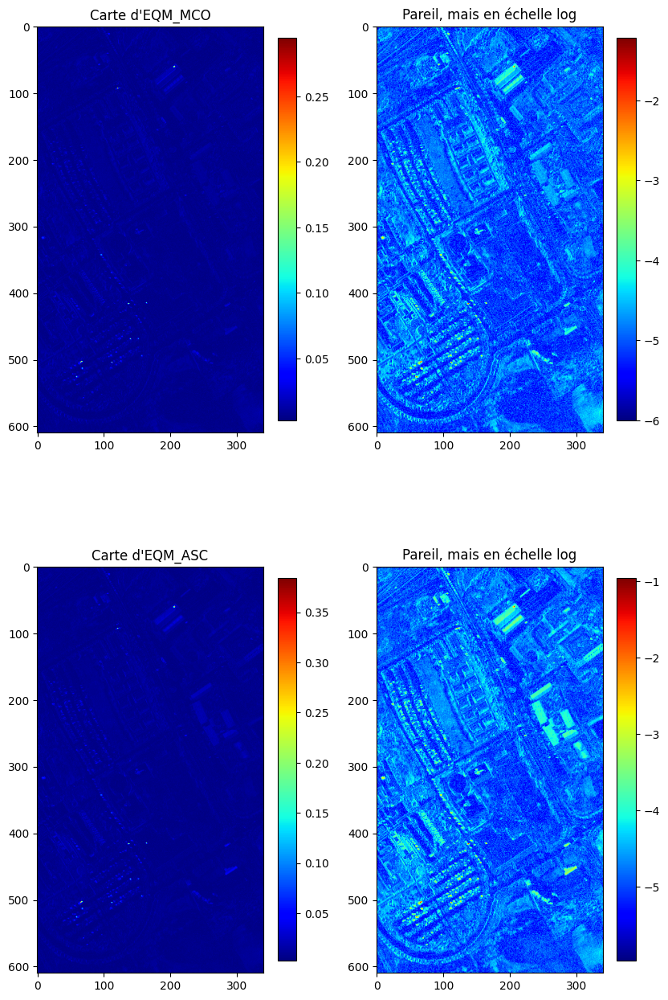

In [29]:
plt.figure(figsize=(10,16))
plt.subplot(221)
plt.title("Carte d'EQM_MCO")
plt.imshow(eps_X_mco,cmap='jet') # en échelle normale, où on ne voit pas grand chose à cause de quelques outliers
plt.colorbar(shrink=0.85)
plt.subplot(222)
plt.title('Pareil, mais en échelle log')
plt.imshow(np.log(eps_X_mco),cmap='jet') # en échelle log, on voit un peu plus la structure spatiale de l'erreur
plt.colorbar(shrink=0.85)

plt.subplot(223)
plt.title("Carte d'EQM_ASC")
plt.imshow(eps_X_asc,cmap='jet') # en échelle normale, où on ne voit pas grand chose à cause de quelques outliers
plt.colorbar(shrink=0.85)
plt.subplot(224)
plt.title('Pareil, mais en échelle log')
plt.imshow(np.log(eps_X_asc),cmap='jet') # en échelle log, on voit un peu plus la structure spatiale de l'erreur
plt.colorbar(shrink=0.85)
plt.show()

#### 1.4) Réppliquez la stratégie de classification ou chaque pixel de la vérité terrain est classifié selon son abondance fractionnelle majoritaire, visualisez la carte de classification obtenue et comparez à celle des MCO. Que pouvez vous en conclure ?

⚠️ Pensez à exclure la classe 9 de la vérité terrain

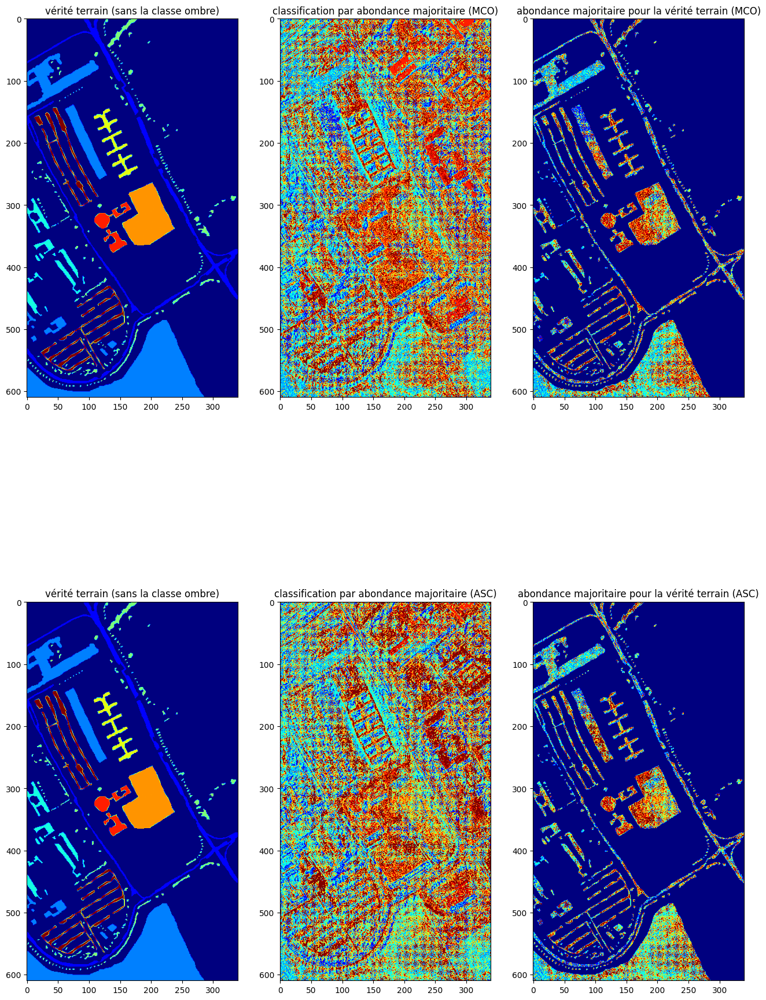

In [30]:
# TODO
argmaxPhi_ASC = np.argmax(Phi_ASC, axis=2) + 1
new_gt = gt * (gt < 9)
argmaxPhi_ASC_mask = argmaxPhi_ASC * (new_gt > 0)

argmaxPhi_MCO = LSU_MCO_results["classif_full"]
argmaxPhi_MCO_mask = LSU_MCO_results["classif_filtered"]

plt.figure(figsize=(16,24))
plt.subplot(231)
plt.title('vérité terrain (sans la classe ombre)')
plt.imshow(gt*(gt<9),cmap='jet',vmin=0,vmax=8)
plt.subplot(232)
plt.title('classification par abondance majoritaire (MCO)')
plt.imshow(argmaxPhi_MCO,cmap='jet',vmin=0,vmax=8)
plt.subplot(233)
plt.title('abondance majoritaire pour la vérité terrain (MCO)')
plt.imshow(argmaxPhi_MCO_mask,cmap='jet',vmin=0,vmax=8)

plt.subplot(234)
plt.title('vérité terrain (sans la classe ombre)')
plt.imshow(gt*(gt<9),cmap='jet',vmin=0,vmax=8)
plt.subplot(235)
plt.title('classification par abondance majoritaire (ASC)')
plt.imshow(argmaxPhi_ASC,cmap='jet',vmin=0,vmax=8)
plt.subplot(236)
plt.title('abondance majoritaire pour la vérité terrain (ASC)')
plt.imshow(argmaxPhi_ASC_mask,cmap='jet',vmin=0,vmax=8)
plt.show()

In [31]:
# La classification obtenue est globalement proche de celle obtenue par mco

#### 1.5) Complétez votre analyse précédente par une évaluation quantitative : taux de bonne classification globale, matrice de confusion et taux de bonne classification par classe, et comparez aux résultats des MCO. Est-ce que l'introduction de l'ASC dans la problématique de démélange change significativement la donne ?

⚠️ Une fois encore, pensez bien à utiliser la vérité terrain sans considérer la classe ombre ni les pixels sans classe

In [32]:
# Taux de bonne classification globale
OA_MCO = LSU_MCO_results["overall_acc"]

new_gt_filtered = new_gt[new_gt > 0]
argmaxPhi_ASC_mask_filtered = argmaxPhi_ASC_mask[new_gt > 0]

OA_ASC_mat = (new_gt_filtered == argmaxPhi_ASC_mask_filtered)

OA_ASC = np.sum(OA_ASC_mat) / OA_ASC_mat.shape[0]

print('Taux de bonne classification globale (MCO) : %1.2f%%'%(100*OA_MCO).astype(float))
print('Taux de bonne classification globale (ASC) : %1.2f%%'%(100*OA_ASC).astype(float))

Taux de bonne classification globale (MCO) : 28.50%
Taux de bonne classification globale (ASC) : 28.98%


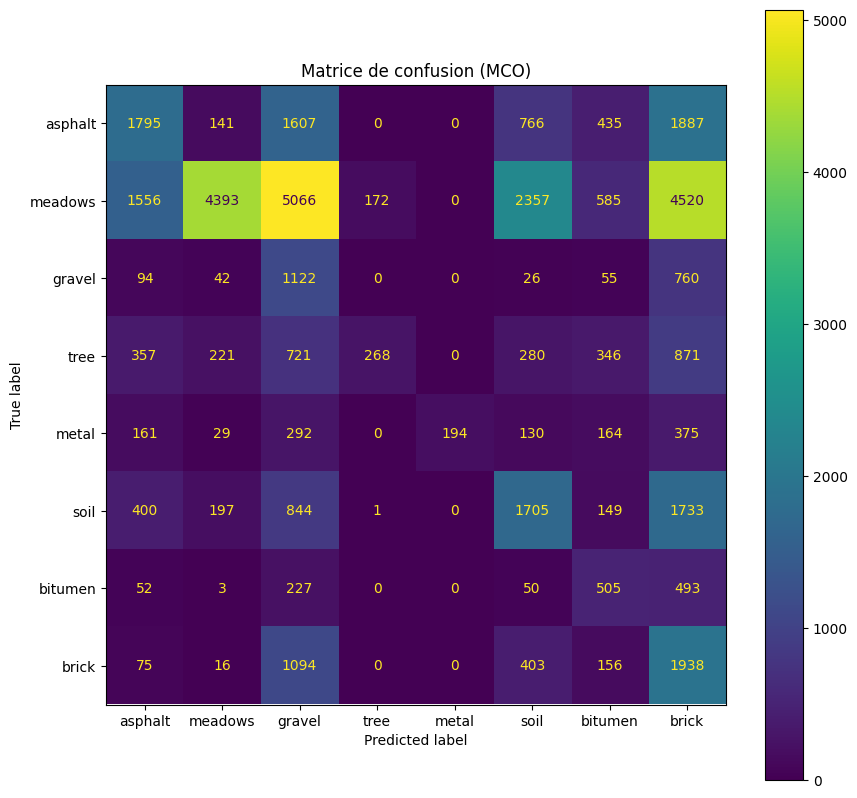

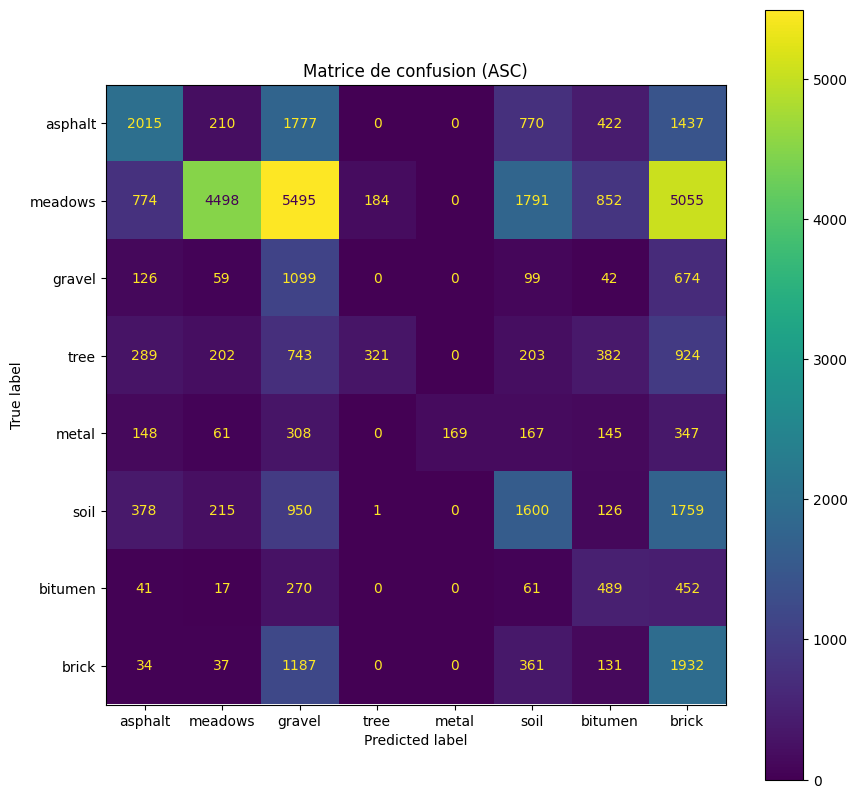

In [33]:
# Matrice de confusion
CM_ASC = sklearn.metrics.confusion_matrix(new_gt_filtered, argmaxPhi_ASC_mask_filtered)
CM_MCO = LSU_MCO_results["confusion_matrix"]

CMplot_MCO = sklearn.metrics.ConfusionMatrixDisplay(CM_MCO,display_labels=endmembers)
fig,ax = plt.subplots(figsize=(10,10))
CMplot_MCO.plot(ax=ax)
plt.title("Matrice de confusion (MCO)")
plt.show()

CMplot_ASC = sklearn.metrics.ConfusionMatrixDisplay(CM_ASC,display_labels=endmembers)
fig,ax = plt.subplots(figsize=(10,10))
CMplot_ASC.plot(ax=ax)
plt.title("Matrice de confusion (ASC)")
plt.show()

In [34]:
# Classification par classe
CA_MCO = CM_MCO.diagonal()/CM_MCO.sum(axis=1)
for i,c in enumerate(endmembers):
    print('Taux de bonne classification pour la classe (mco) %s : %1.3f%%'%(c,100*CA_MCO[i]))
    
print("\n")

CA_ASC = CM_ASC.diagonal()/CM_ASC.sum(axis=1)
for i,c in enumerate(endmembers):
    print('Taux de bonne classification pour la classe (asc) %s : %1.3f%%'%(c,100*CA_ASC[i]))

Taux de bonne classification pour la classe (mco) asphalt : 27.070%
Taux de bonne classification pour la classe (mco) meadows : 23.556%
Taux de bonne classification pour la classe (mco) gravel : 53.454%
Taux de bonne classification pour la classe (mco) tree : 8.747%
Taux de bonne classification pour la classe (mco) metal : 14.424%
Taux de bonne classification pour la classe (mco) soil : 33.903%
Taux de bonne classification pour la classe (mco) bitumen : 37.970%
Taux de bonne classification pour la classe (mco) brick : 52.634%


Taux de bonne classification pour la classe (asc) asphalt : 30.388%
Taux de bonne classification pour la classe (asc) meadows : 24.119%
Taux de bonne classification pour la classe (asc) gravel : 52.358%
Taux de bonne classification pour la classe (asc) tree : 10.477%
Taux de bonne classification pour la classe (asc) metal : 12.565%
Taux de bonne classification pour la classe (asc) soil : 31.815%
Taux de bonne classification pour la classe (asc) bitumen : 36.767%

On peut en conclure que malgré quelques légères différences de valeurs entre les taux de classification, celles-ci restent globalement proches et varient peu. On peut douter qu'il y ait une différence significative entre mco et asc pour ce jeu de données.

## II. Démélange avec contrainte de positivité

Dans un deuxième temps, on ne va considérer que la contrainte de positivité des abondances. Contrairement à la contrainte de somme à 1, la positivité n'admet pas de solution analytique. Ça ne veut pas dire pour autant qu'elle n'admet pas de solution, juste que cette dernière ne pourra s'obtenir que par un algorithme itératif (du genre descente de gradient).

Dans cette partie, on se penche maintenant sur la résolution du problème suivant :

$$\arg\min_{\substack{\boldsymbol \phi \in \mathbb{R}^m\\[2pt] \boldsymbol \phi \ \mathbf{\succeq 0}}} \| \mathbf{x} - \mathbf{E} \boldsymbol \phi\|_2^2 \quad (7)
$$

Le symbole $\succeq$ dans la contrainte $\boldsymbol \phi \ \mathbf{\succeq 0}$ du problème d'optimisation (7) ci-dessus est à prendre au sens "inégalité composante par composante", c'est-à-dire $\boldsymbol \phi \ \mathbf{\succeq 0} \Leftrightarrow \phi_i \geq 0 \ \forall i=1,\dots,m$. Cette contrainte de positivité sera abrégée par ANC (pour <i> abundance non-negativity constraint</i>).

Contrairement à l'ASC qui n'impose qu'une seule contrainte d'égalité au problème d'optimisation (6), l'ANC impose $m$ contraintes d'inégalités au problème (7). Le fait que ce soit des inégalités et non des égalités va également en compliquer un peu sa résolution (et c'est en particulier la raison pour laquelle il n'existe pas de solution analytique à (7))

Le problème de moindres carrés avec contrainte de positivité est un cas particulier de problèmes d'optimisation quadratiques convexes (qui sont eux-mêmes un cas particulier des problèmes d'optimisation quadratiques, où la fonction objective à minimiser n'est pas nécessaire convexe).

Plus particulièrement, un problème d'optimisation quadratique convexe est défini par 

$$ \arg\min_{\substack{\mathbf{A}\mathbf{x} \preceq \mathbf{b}\\[2pt] \mathbf{C}\mathbf{x} = \mathbf{d}}} = \frac{1}{2}\, \mathbf{x}^T \mathbf{Q} \mathbf{x} + \mathbf{c}^T \mathbf{x} \quad (QP)$$ 

avec pour la fonction objective $\mathbf{x} \in \mathbb{R}^m$, $\mathbf{c} \in \mathbb{R}^m$ et $\mathbf{Q} \in \mathbb{R}^{m \times m}$ une matrice symétrique positive et des paires matrice/vecteurs $(\mathbf{A},\mathbf{b})$ et $(\mathbf{C},\mathbf{d})$ définissant des contraintes d'inégalités ($\preceq$ étant à prendre également au sens composante par composante) et d'égalité.

Dans un problème d'optimisation quadratique convexe, on cherche donc à minimiser une fonction quadratique sur un espace admissible défini comme un polyèdre convexe (mais non nécessairement borné).

<img src="figs/quadratic-programming.jpg" width=400 />

#### 2.1 Montrez que le problème d'optimisation (7) se met bien sous la forme d'un problème (QP) et identifiez les différents éléments $(\mathbf{Q},\mathbf{c})$ et $(\mathbf{A},\mathbf{b})$

Il est évident que  $(\mathbf{C},\mathbf{d}) = (\mathbf{0},\mathbf{0})$

<img src="figs/demo.png" width=500 />

In [35]:
# TODO
m = E.shape[1]

Q = 2 * (E.T @ E)
c = -2 * (E.T @ x)

A = -np.eye(m)
b = np.zeros(m)

C = np.zeros((m, m))
d = np.zeros(m)

Q.shape, c.shape, A.shape, b.shape, C.shape, d.shape

((8, 8), (8,), (8, 8), (8,), (8, 8), (8,))

Il existe plusieurs manières de [résoudre des problèmes d'optimisation quadratique](https://fr.wikipedia.org/wiki/Optimisation_quadratique) et plusieurs solveurs qui permettent le faire en Python (par exemple [CVXPT](https://cvxopt.org/userguide/coneprog.html) et [quadprog](https://github.com/quadprog/quadprog). Dans notre cas, on peut même faire encore plus simple puisqu'il existe une fonction built-in de `scipy` qui permet de résoudre un problème de moindres carrés avec ANC : [`scipy.optimize.nnls`](https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.nnls.html)

[`scipy.optimize.nnls`](https://docs.scipy.org/doc/scipy/reference/generated/scipy.optimize.nnls.html) implémente l'aglorithme de Lawson et Hanson (<i>Lawson, Charles L.; Hanson, Richard J. (1995). Solving Least Squares Problems. SIAM</i>), qui est un algorithme d'<b>[ensemble actif](https://fr.wikipedia.org/wiki/Ensemble_actif)</b>.

Sans (trop) rentrer dans les détails, voici le principe de cet algorithme :<br>
On dit qu'une contrainte d'inégalité $g(\mathbf{x}) \leq 0$ est <b>active</b> dans un problème d'optimisation si $g(\mathbf{x}^\star) = 0$ au point optimal $\mathbf{x}^\star$. On appelle <b>ensemble actif</b> l'ensemble des contraintes actives. À noter qu'une contrainte d'égalité $h(\mathbf{x}) = 0$ est, par définition, toujours active. Une contrainte qui n'est pas active est dite <b>passive</b>, et l'ensemble des contraintes passives forme l'ensemble passif.
L'idée d'un algorithme d'ensemble actif est d'identifier de manière itérative quel est l'ensemble actif.

Dans le cas des moindres carrés avec contrainte de positivité, on dit que la i$^\text{ème}$ contrainte est active si $\phi_i \leq 0$ dans le problème d'optimisation sans contrainte (3). En effet, il faudra forcer $\phi_i$ à 0 pour la résolution de (7), d'où le fait que cette contrainte soit active. Si l'ensemble actif est connu (donc l'ensemble des indices $\{i\}$ tel que $\phi_i = 0$, alors la solution de (7) est la solution sans contrainte des moindres carrés restreints aux variables passives.

L'écriture des conditions KKT pour le problème d'optimisation (7) donne :
* stationnarité : $\nabla_{\boldsymbol \phi} \mathcal{L}(\boldsymbol \phi,\boldsymbol \mu) = 0 \Leftrightarrow \boldsymbol \mu = 2 \mathbf{E}^T(\mathbf{E} \boldsymbol \phi - \mathbf{x})$ avec $\boldsymbol \mu \in \mathbb{R}^m$ le vecteur de multiplicateurs de Lagrange associé aux $m$ contraines d'inégalités $\phi_i \geq 0, i=1,\dots,m$
* admissibilité primale : $\boldsymbol \phi \succeq \mathbf{0}$ (respect des contraintes pour la variable primale au point optimal)
* admissibilité duale : $\boldsymbol \mu \succeq \mathbf{0}$  (les multiplicateurs de Lagrange associés aux contraintes d'inégalités sont $\geq$ au point optimal)
* complémentarité : $\boldsymbol \mu^T \boldsymbol \phi = \mathbf{0}$ au point optimal

Basées sur ces conditions KKT, l'algorithme de Lawson et Hanson effectue les itérations suivantes :
* <b> Initialisation</b> : $\boldsymbol \phi = \mathbf{0}$, autrement dit, toutes les contraintes sont actives
* <b> À chaque itération</b> :<br>
    * calcul du vecteur de multiplicateurs de Lagrange
    * passage dans l'ensemble passif de la contrainte dont le multiplicateur est le plus négatif
    * calcul de la solution des moindres carrés sans contraintes restreints uniquement aux variables passives
    
Au bout d'un nombre fini d'itérations, l'ensemble actif final est trouvé, et la solution des moindres carrés sans contraintes sur l'ensemble passif complémentaire donne la solution finale du problème avec contraintes.<br>

Cette procédure est illustrée schématiquement par la figure ci-dessous :
<img src="figs/active_set_illustration.png" width=600 />
Ainsi, à partir d'une solution admissible initiale, l'algorithme d'ensembe actif revient à se "promener" sur certaines arêtes du polyèdre définit par les contraintes d'inégalités, un peu comme l'[algorithme du simplexe](https://fr.wikipedia.org/wiki/Algorithme_du_simplexe) pour les programmes linéaires.

Sans surprise, on va suivre dans cette partie pour le démélage avec ANC les mêmes étapes que dans la partie 1 pour le démélange avec ASC

#### 2.2) Vérifiez sur quelques spectres que la solution de (7) donnée par `scipy.optimize.nnls` fonctionne qualitativement et quantitativement

Faites les mêmes vérifications qualitatives et quantitatives que pour le démélange avec ASC. Que pouvez-vous en conclure ?

In [36]:
# TODO
phi_anc = optimize.nnls(E, x)

phi_anc[0].shape

(8,)

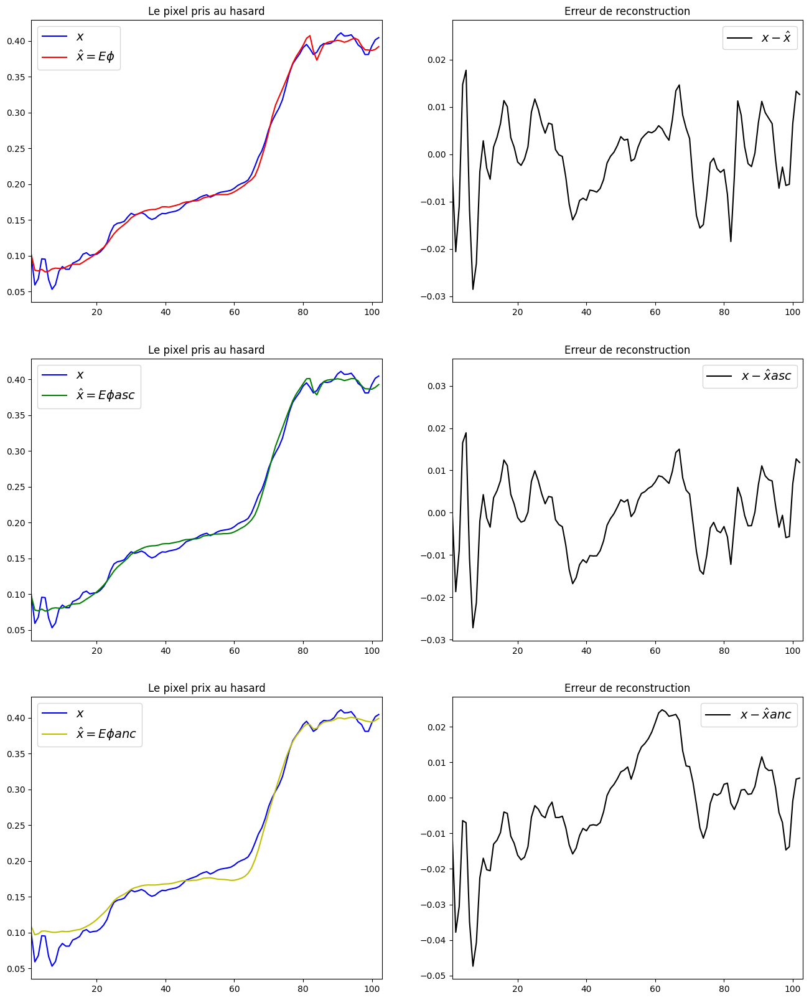

In [37]:
# TODO
plt.figure(figsize=(16,20))

plt.subplot(321)
plt.plot(x,'b',label=r'$x$')
plt.plot(E @ LSU(E,x),'r',label=r'$\hat{x} = E\phi$')
plt.title('Le pixel pris au hasard')
plt.legend(loc='best',fontsize=14)
plt.xlim((1,103))

plt.subplot(322)
plt.plot(x - E @ LSU(E,x),'k',label=r'$x - \hat{x}$')
plt.title('Erreur de reconstruction')
plt.xlim((1,103))
plt.legend(loc='best',fontsize=14)

plt.subplot(323)
plt.plot(x,'b',label=r'$x$')
plt.plot(E @ phi_asc,'g',label=r'$\hat{x} = E\phi{asc}$')
plt.title('Le pixel pris au hasard')
plt.legend(loc='best',fontsize=14)
plt.xlim((1,103))

plt.subplot(324)
plt.plot(x - E @ phi_asc,'k',label=r'$x - \hat{x}asc$')
plt.title('Erreur de reconstruction')
plt.xlim((1,103))
plt.legend(loc='best',fontsize=14)

plt.subplot(325)
plt.plot(x,'b',label=r'$x$')
plt.plot(E @ phi_anc[0],'y',label=r'$\hat{x} = E\phi{anc}$')
plt.title('Le pixel prix au hasard')
plt.legend(loc='best',fontsize=14)
plt.xlim((1,103))

plt.subplot(326)
plt.plot(x - E @ phi_anc[0],'k',label=r'$x - \hat{x}anc$')
plt.title('Erreur de reconstruction')
plt.xlim((1,103))
plt.legend(loc='best',fontsize=14)

plt.show()

In [38]:
squared_errors_mco = (x - E @ LSU(E, x)) ** 2
rmse_mco = np.sqrt(np.mean(squared_errors_mco))

squared_errors_asc = (x - E @ phi_asc) ** 2
rmse_asc = np.sqrt(np.mean(squared_errors_asc)) # rmse = root_mean_squared_error

squared_errors_anc = (x - E @ phi_anc[0]) ** 2
rmse_anc = np.sqrt(np.mean(squared_errors_anc))

rmse_mco, rmse_asc, rmse_anc

# On peut en conclure que la solution trouvée par anc est bien optimale mais un peu moins précise que celle trouvée par mco et asc, 
# comportement prévisible étant que la contrainte rajoute une difficulté supplémentaire pour trouver la solution la plus optimale possible, 
# et que la solution trouvée itérativement peut augmenter la compléxité des calculs et l'imprécision

(0.008897869531782595, 0.009163215006380314, 0.014113024228399476)

#### 2.3) Calculez la matrice d'abondances $\boldsymbol \Phi$ pour toute l'image, puis affichez ces cartes d'abondances fractionnelles et la carte d'erreur quadratique moyenne de reconstruction pour l'image entière. Comparez avec les résultats obtenus par MCO avec et sans ASC

Ici, de la même manière que dans la partie précédente, il faut boucler sur tous les pixels de l'image pour obtenir les cartes d'abondances $\boldsymbol \Phi$

In [39]:
# TODO
def find_anc(E, x) :
    phi_anc_ = optimize.nnls(E, x)
    
    return phi_anc_[0]

In [40]:
# TODO
Phi_MCO = LSU(E, hsir.T)

Phi_MCO = Phi_MCO.reshape(m,Nrow,Ncol) # reshape en un cube 3D m x Nrow x Ncol
Phi_MCO = np.moveaxis(Phi_MCO,0,-1) # reshape finalement en un cube 3d Nrow x Ncol x m

Phi_ASC = []
Phi_ANC = []

for i in range(hsir.shape[0]) :
    x_ = hsir[i, :]
    
    phi_asc_ = find_asc(E, x_)
    phi_anc_ = find_anc(E, x_)
    
    Phi_ASC.append(phi_asc_)
    Phi_ANC.append(phi_anc_)

Phi_ASC = np.array(Phi_ASC).reshape((Nrow, Ncol, m))
Phi_ANC = np.array(Phi_ANC).reshape((Nrow, Ncol, m))

Phi_MCO.shape, Phi_ASC.shape, Phi_ANC.shape

((610, 340, 8), (610, 340, 8), (610, 340, 8))

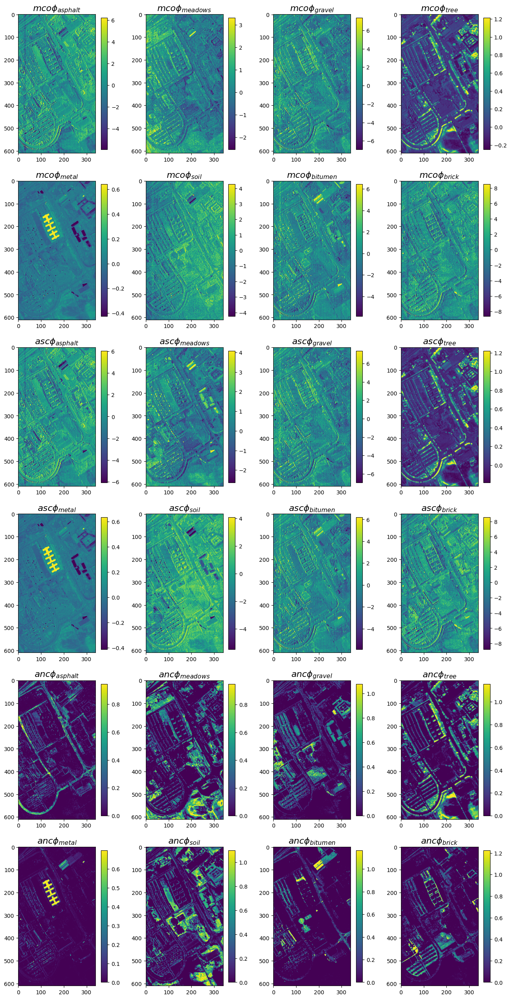

In [41]:
perc=1 # =1 si on veut filtrer un peu, =0 sinon
plow_MCO, phigh_MCO = np.percentile(Phi_MCO, (perc, 100-perc),axis=(0,1))
plow_ASC, phigh_ASC = np.percentile(Phi_ASC, (perc, 100-perc),axis=(0,1))
plow_ANC, phigh_ANC = np.percentile(Phi_ANC, (perc, 100-perc),axis=(0,1))
plt.figure(figsize=(16,32))
plt.tight_layout()
for i in range(24):
    if (i < 8) :
        plt.subplot(6,4,i+1)
        plt.imshow(Phi_MCO[:,:,i], vmin=plow_MCO[i], vmax=phigh_MCO[i])
        plt.title(r'$mco\phi_{%s}$'%endmembers[i],fontsize=16)
        plt.colorbar(shrink=0.95)
    elif (i < 16) :
        plt.subplot(6,4,i+1)
        plt.imshow(Phi_ASC[:,:,i - 8], vmin=plow_ASC[i - 8], vmax=phigh_ASC[i - 8])
        plt.title(r'$asc\phi_{%s}$'%endmembers[i - 8],fontsize=16)
        plt.colorbar(shrink=0.95)
    else :
        plt.subplot(6,4,i+1)
        plt.imshow(Phi_ANC[:,:,i - 16], vmin=plow_ANC[i - 16], vmax=phigh_ANC[i - 16])
        plt.title(r'$anc\phi_{%s}$'%endmembers[i - 16],fontsize=16)
        plt.colorbar(shrink=0.95)
plt.show()

In [42]:
eps_X_mco = LSU_MCO_results["RMSE"]

X_asc = Phi_ASC @ E.T
eps_X_asc = np.sqrt(np.mean((hsi - X_asc) ** 2, axis=2))

X_anc = Phi_ANC @ E.T
eps_X_anc = np.sqrt(np.mean((hsi - X_anc) ** 2, axis=2))

eps_X_mco.shape, eps_X_asc.shape, eps_X_anc.shape

((610, 340), (610, 340), (610, 340))

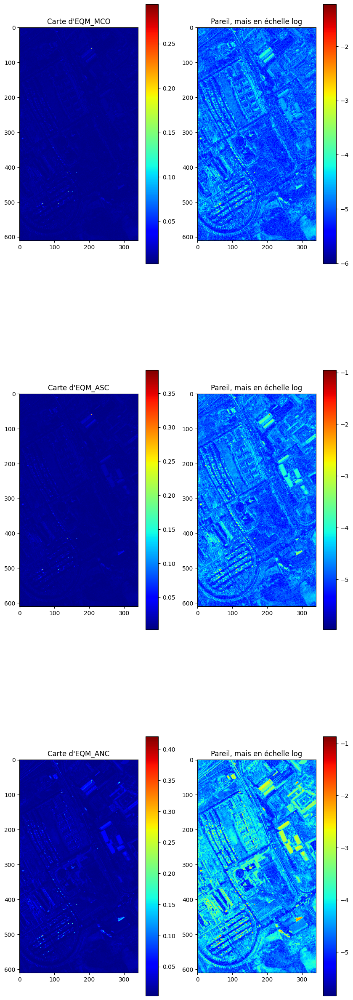

In [43]:
plt.figure(figsize=(10,32))
plt.subplot(321)
plt.title("Carte d'EQM_MCO")
plt.imshow(eps_X_mco,cmap='jet') # en échelle normale, où on ne voit pas grand chose à cause de quelques outliers
plt.colorbar(shrink=0.85)
plt.subplot(322)
plt.title('Pareil, mais en échelle log')
plt.imshow(np.log(eps_X_mco),cmap='jet') # en échelle log, on voit un peu plus la structure spatiale de l'erreur
plt.colorbar(shrink=0.85)

plt.subplot(323)
plt.title("Carte d'EQM_ASC")
plt.imshow(eps_X_asc,cmap='jet') # en échelle normale, où on ne voit pas grand chose à cause de quelques outliers
plt.colorbar(shrink=0.85)
plt.subplot(324)
plt.title('Pareil, mais en échelle log')
plt.imshow(np.log(eps_X_asc),cmap='jet') # en échelle log, on voit un peu plus la structure spatiale de l'erreur
plt.colorbar(shrink=0.85)

plt.subplot(325)
plt.title("Carte d'EQM_ANC")
plt.imshow(eps_X_anc,cmap='jet') # en échelle normale, où on ne voit pas grand chose à cause de quelques outliers
plt.colorbar(shrink=0.85)
plt.subplot(326)
plt.title('Pareil, mais en échelle log')
plt.imshow(np.log(eps_X_anc),cmap='jet') # en échelle log, on voit un peu plus la structure spatiale de l'erreur
plt.colorbar(shrink=0.85)
plt.show()

#### 2.4) Réppliquez la stratégie de classification ou chaque pixel de la vérité terrain est classifié selon son abondance fractionnelle majoritaire, visualisez la carte de classification obtenue et comparez à celle des MCO avec et sans ASC. Que pouvez vous en conclure ?

⚠️ Pensez toujours à exclure la classe 9 de la vérité terrain

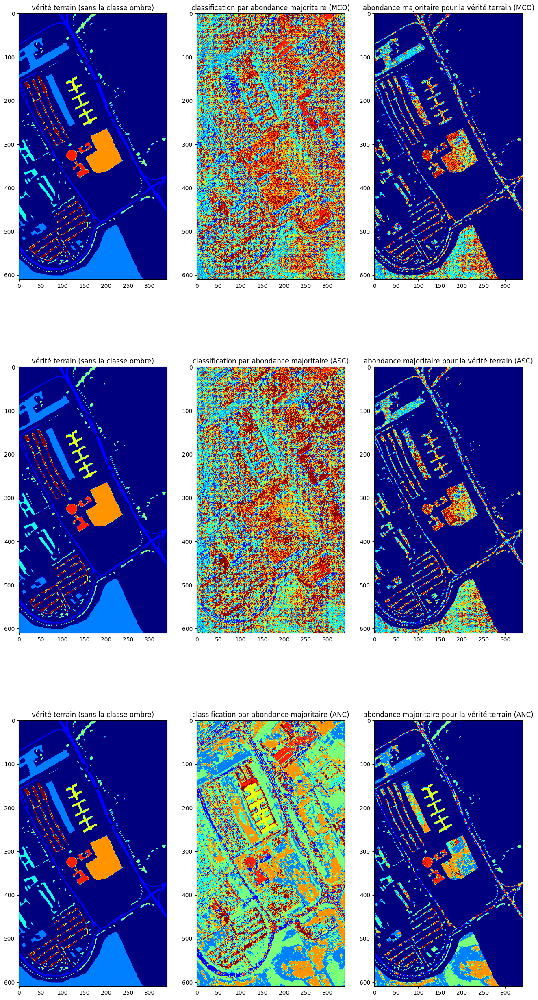

In [44]:
# TODO
argmaxPhi_ASC = np.argmax(Phi_ASC, axis=2) + 1
new_gt = gt * (gt < 9)
argmaxPhi_ASC_mask = argmaxPhi_ASC * (new_gt > 0)

argmaxPhi_ANC = np.argmax(Phi_ANC, axis=2) + 1
new_gt = gt * (gt < 9)
argmaxPhi_ANC_mask = argmaxPhi_ANC * (new_gt > 0)

argmaxPhi_MCO = LSU_MCO_results["classif_full"]
argmaxPhi_MCO_mask = LSU_MCO_results["classif_filtered"]

plt.figure(figsize=(16,32))
plt.subplot(331)
plt.title('vérité terrain (sans la classe ombre)')
plt.imshow(gt*(gt<9),cmap='jet',vmin=0,vmax=8)
plt.subplot(332)
plt.title('classification par abondance majoritaire (MCO)')
plt.imshow(argmaxPhi_MCO,cmap='jet',vmin=0,vmax=8)
plt.subplot(333)
plt.title('abondance majoritaire pour la vérité terrain (MCO)')
plt.imshow(argmaxPhi_MCO_mask,cmap='jet',vmin=0,vmax=8)

plt.subplot(334)
plt.title('vérité terrain (sans la classe ombre)')
plt.imshow(gt*(gt<9),cmap='jet',vmin=0,vmax=8)
plt.subplot(335)
plt.title('classification par abondance majoritaire (ASC)')
plt.imshow(argmaxPhi_ASC,cmap='jet',vmin=0,vmax=8)
plt.subplot(336)
plt.title('abondance majoritaire pour la vérité terrain (ASC)')
plt.imshow(argmaxPhi_ASC_mask,cmap='jet',vmin=0,vmax=8)

plt.subplot(337)
plt.title('vérité terrain (sans la classe ombre)')
plt.imshow(gt*(gt<9),cmap='jet',vmin=0,vmax=8)
plt.subplot(338)
plt.title('classification par abondance majoritaire (ANC)')
plt.imshow(argmaxPhi_ANC,cmap='jet',vmin=0,vmax=8)
plt.subplot(339)
plt.title('abondance majoritaire pour la vérité terrain (ANC)')
plt.imshow(argmaxPhi_ANC_mask,cmap='jet',vmin=0,vmax=8)
plt.show()

#### 2.5) Complétez votre analyse précédente par une évaluation quantitative : taux de bonne classification globale, matrice de confusion et taux de bonne classification par classe, et comparez aux résultats des MCO avec et sans ASC. Est-ce que l'introduction de l'ANC dans la problématique de démélange change significativement la donne ?

⚠️ Une fois encore, pensez bien à utiliser la vérité terrain sans considérer la classe ombre ni les pixels sans classe

In [45]:
# Taux de bonne classification globale
OA_MCO = LSU_MCO_results["overall_acc"]

new_gt_filtered = new_gt[new_gt > 0]
argmaxPhi_ASC_mask_filtered = argmaxPhi_ASC_mask[new_gt > 0]

OA_ASC_mat = (new_gt_filtered == argmaxPhi_ASC_mask_filtered)

OA_ASC = np.sum(OA_ASC_mat) / OA_ASC_mat.shape[0]

new_gt_filtered = new_gt[new_gt > 0]
argmaxPhi_ANC_mask_filtered = argmaxPhi_ANC_mask[new_gt > 0]

OA_ANC_mat = (new_gt_filtered == argmaxPhi_ANC_mask_filtered)

OA_ANC = np.sum(OA_ANC_mat) / OA_ANC_mat.shape[0]

print('Taux de bonne classification globale (MCO) : %1.2f%%'%(100*OA_MCO).astype(float))
print('Taux de bonne classification globale (ASC) : %1.2f%%'%(100*OA_ASC).astype(float))
print('Taux de bonne classification globale (ANC) : %1.2f%%'%(100*OA_ANC).astype(float))

Taux de bonne classification globale (MCO) : 28.50%
Taux de bonne classification globale (ASC) : 28.98%
Taux de bonne classification globale (ANC) : 58.60%


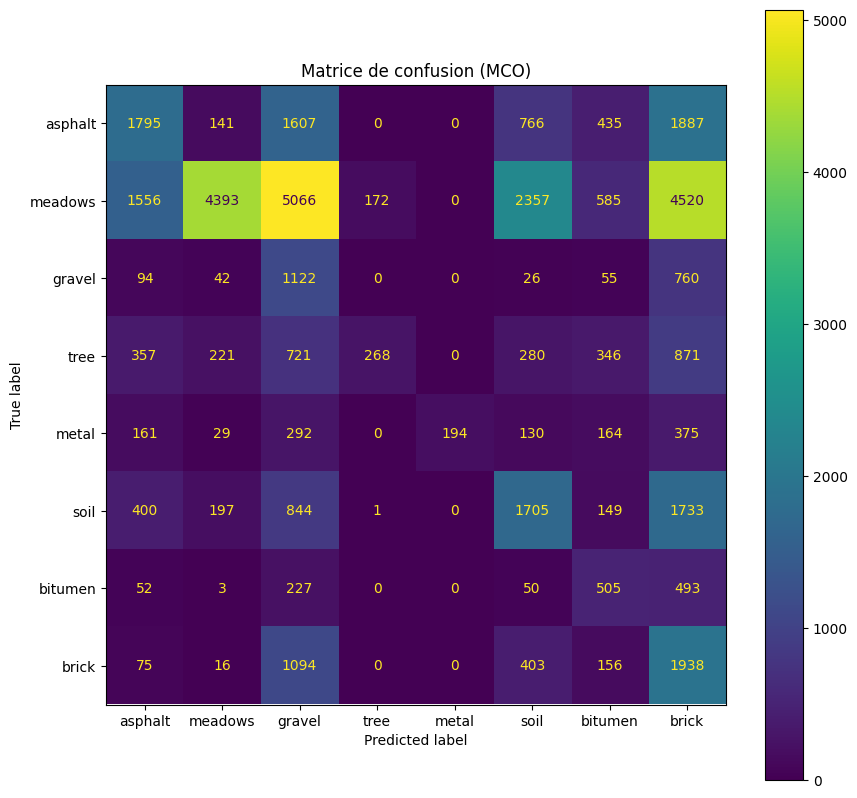

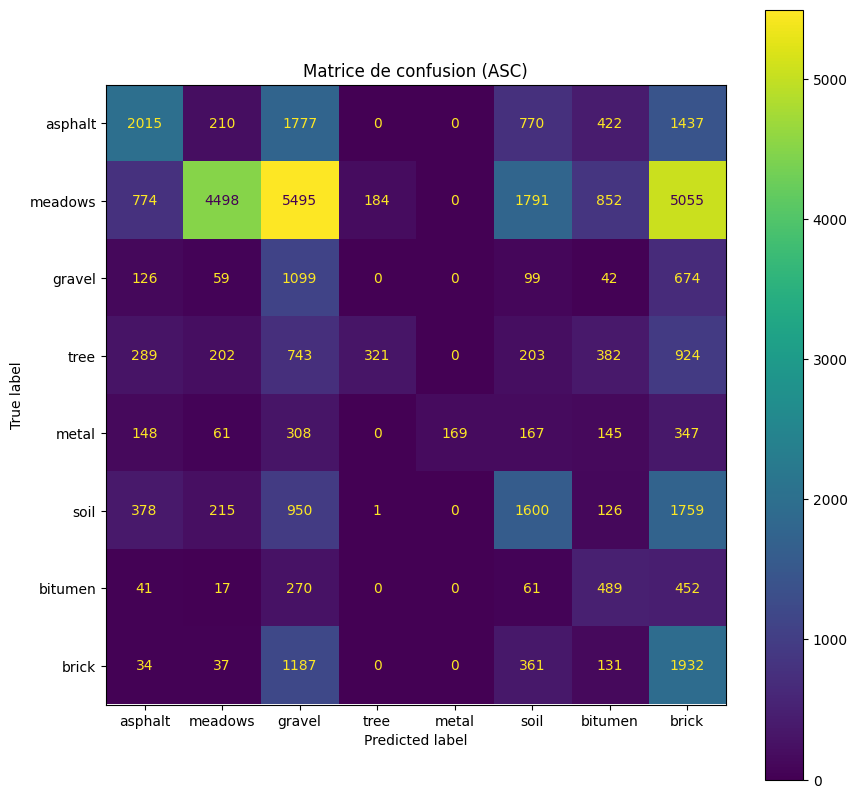

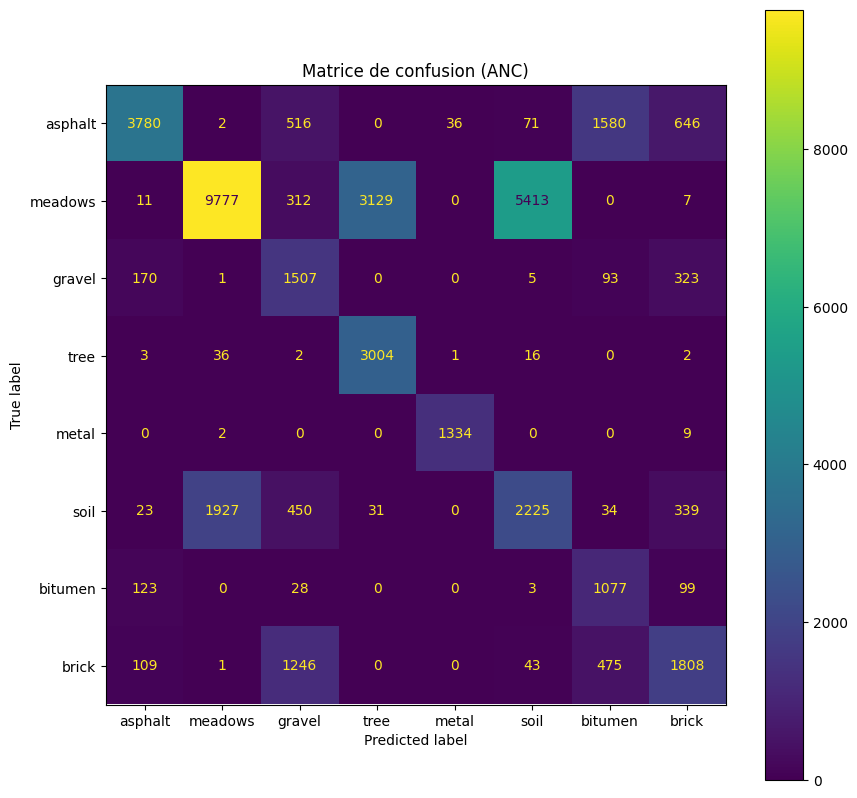

In [46]:
# Matrice de confusion
CM_ASC = sklearn.metrics.confusion_matrix(new_gt_filtered, argmaxPhi_ASC_mask_filtered)
CM_ANC = sklearn.metrics.confusion_matrix(new_gt_filtered, argmaxPhi_ANC_mask_filtered)
CM_MCO = LSU_MCO_results["confusion_matrix"]

CMplot_MCO = sklearn.metrics.ConfusionMatrixDisplay(CM_MCO,display_labels=endmembers)
fig,ax = plt.subplots(figsize=(10,10))
CMplot_MCO.plot(ax=ax)
plt.title("Matrice de confusion (MCO)")
plt.show()

CMplot_ASC = sklearn.metrics.ConfusionMatrixDisplay(CM_ASC,display_labels=endmembers)
fig,ax = plt.subplots(figsize=(10,10))
CMplot_ASC.plot(ax=ax)
plt.title("Matrice de confusion (ASC)")

CMplot_ANC = sklearn.metrics.ConfusionMatrixDisplay(CM_ANC,display_labels=endmembers)
fig,ax = plt.subplots(figsize=(10,10))
CMplot_ANC.plot(ax=ax)
plt.title("Matrice de confusion (ANC)")
plt.show()

In [47]:
# Classification par classe
CA_MCO = CM_MCO.diagonal()/CM_MCO.sum(axis=1)
for i,c in enumerate(endmembers):
    print('Taux de bonne classification pour la classe (mco) %s : %1.3f%%'%(c,100*CA_MCO[i]))
    
print("\n")

CA_ASC = CM_ASC.diagonal()/CM_ASC.sum(axis=1)
for i,c in enumerate(endmembers):
    print('Taux de bonne classification pour la classe (asc) %s : %1.3f%%'%(c,100*CA_ASC[i]))

print("\n")

CA_ANC = CM_ANC.diagonal()/CM_ANC.sum(axis=1)
for i,c in enumerate(endmembers):
    print('Taux de bonne classification pour la classe (anc) %s : %1.3f%%'%(c,100*CA_ANC[i]))

Taux de bonne classification pour la classe (mco) asphalt : 27.070%
Taux de bonne classification pour la classe (mco) meadows : 23.556%
Taux de bonne classification pour la classe (mco) gravel : 53.454%
Taux de bonne classification pour la classe (mco) tree : 8.747%
Taux de bonne classification pour la classe (mco) metal : 14.424%
Taux de bonne classification pour la classe (mco) soil : 33.903%
Taux de bonne classification pour la classe (mco) bitumen : 37.970%
Taux de bonne classification pour la classe (mco) brick : 52.634%


Taux de bonne classification pour la classe (asc) asphalt : 30.388%
Taux de bonne classification pour la classe (asc) meadows : 24.119%
Taux de bonne classification pour la classe (asc) gravel : 52.358%
Taux de bonne classification pour la classe (asc) tree : 10.477%
Taux de bonne classification pour la classe (asc) metal : 12.565%
Taux de bonne classification pour la classe (asc) soil : 31.815%
Taux de bonne classification pour la classe (asc) bitumen : 36.767%

En conclusion, la contrainte par ANC permet une meilleure classification globale et par classe des pixels dans notre problème d'optimisation.

#### 2.6 Implémentez vous-mêmes l'algorithme de Lawson et Hanson, et vérifiez que vous obtenez bien les mêmes résultats que scipy

Le pseudo-code ce cet algorithme est disponible [ici](https://en.wikipedia.org/wiki/Non-negative_least_squares). Il n'est pas nécessaire de le comprendre en détail pour pouvoir l'implémenter (heureusement). Cependant, n'hésitez pas à fouiller un peu plus le net à la recherche d'explications sur le pourquoi du comment de cet algorithme.

In [48]:
# TODO
def lawson_hanson(A, y, epsilon=1e-6):
    m, n = A.shape
    P = set()
    R = set(range(n))
    x = np.zeros(n)
    w = A.T @ (y - A @ x)

    while R and max(w[list(R)]) > epsilon:
        j = max(R, key=lambda j: w[j])
        P.add(j)
        R.remove(j)
        AP = A[:, list(P)]
        s = np.zeros(n)
        sP = np.linalg.solve(AP.T @ AP, AP.T @ y)
        s[list(P)] = sP

        while min(sP) <= 0:
            alpha = min([(x[i] / (x[i] - s[i])) for i in P if s[i] <= 0])
            x = x + alpha * (s - x)
            R.update([j for j in P if x[j] <= 0])
            AP = A[:, list(P)]
            sP = np.linalg.solve(AP.T @ AP, AP.T @ y)
            s[list(P)] = sP

        x = s
        w = A.T @ (y - A @ x)

    return x

In [49]:
a, b = 5, 5
A = np.array([[0.08876662, 0.10954014, 0.49095431, 0.9205018, 0.81076777],
              [0.47730249, 0.66235788, 0.61315432, 0.46311339, 0.3344421],
              [0.77899953, 0.95960358, 0.4307715, 0.48715367, 0.8378287],
              [0.53925895, 0.74109245, 0.0487542, 0.40247103, 0.16350409],
              [0.10509434, 0.39456726, 0.7953376, 0.22097909, 0.08884903]])

y = np.array([0.67264812, 0.13111218, 0.4949288, 0.70004854, 0.99638498])

x_lawson_hanson = lawson_hanson(A, y)
x_scipy, _ = optimize.nnls(A, y)

# Comparaison
print("Solution Lawson Hanson:", x_lawson_hanson)
print("Solution SciPy:", x_scipy)

Solution Lawson Hanson: [0.         0.20409881 0.55612023 0.35171495 0.        ]
Solution SciPy: [0.         0.20409881 0.55612023 0.35171495 0.        ]


## Démélange avec contrainte de positivité et de somme à 1

On attaque maintenant le problème complet, à savoir le démélange en intégrant les deux contraintes ANC et ASC simultanément. Le problème d'optimisation à résoudre est donc le problème (4) qui avait été formulé dans l'introduction de ce TP, rappelé ci-dessous :

$$\arg\min_{\boldsymbol \phi \in \mathbb{R}^m\\[2pt] \boldsymbol \phi_i \succeq \mathbf{0} \\[2pt] \mathbf{1}_m^T \boldsymbol \phi= 1} \| \mathbf{x} - \mathbf{E} \boldsymbol \phi\|_2^2 \quad (4)
$$

On abrégera par la suite ce problème d'optimisation (4) par FCLS (pour <i>Fully Constrained Least Square</i>).

Du fait de la présence de l'ANC parmi les contraintes, il n'existe pas de solution analytique au problème (4) (mais ça ne devrait pas être une surprise à ce stade du TP). Idem que pour la partie précédente, on est obligé de se tourner vers des algorithmes itératifs pour résoudre (4).

Dans un premier temps, on va en fait tweaker un peu le problème (4), en incorporant l'ASC dans la fonction objective :

$$\arg\min_{\boldsymbol \phi \in \mathbb{R}^m\\[2pt] \boldsymbol \phi_i \succeq \mathbf{0}} \| \mathbf{x} - \mathbf{E} \boldsymbol \phi\|_2^2 + \delta (\mathbf{1}_m^T \boldsymbol \phi - 1)^2 \quad (4\text{bis})
$$

Dans le problème (4bis), la fonction objective est maintenant définie comme la somme de deux termes : 
* $\| \mathbf{x} - \mathbf{E} \boldsymbol \phi\|_2^2$ qui correspond au terme des moindres carrés classique
* $(\mathbf{1}_m^T \boldsymbol \phi - 1)^2$ qui correspond à un terme de pénalisation, défini comme l'écart au carré entre la somme théorique des valeurs de $\boldsymbol \phi$ (donc 1) et la somme obtenue en pratique (donc $\mathbf{1}_m^T \boldsymbol \phi$). Si la contrainte de somme à 1 est parfaitement respectée, alors il est aisé de voir que le problème (4bis) et le problème (4) coïncident. Si la somme à 1 n'est pas strictement respectée, alors les deux problèmes diffèrent légèrement.<br>

La valeur du coefficient $\delta$ permet de pondérer l'impact du terme de régularisation sur la solution des moindres carrés. $\delta = 0$ ramène donc à résoudre le problème des moindres carrés avec seulement l'ANC. À contrario, plus $\delta$ sera élevé et plus la solution optimale de (4bis) va différer de celle des moindres carrés + ANC, avec une somme à 1 de mieux en mieux respectée (mais en perdant un peu de justesse au niveau des coefficients des moindres carrés).

#### 3.1 En développant la fonction objective comme $(\mathbf{E} \boldsymbol \phi - \mathbf{x})^T(\mathbf{E} \boldsymbol \phi - \mathbf{x}) + \delta (\mathbf{1}_m^T \boldsymbol \phi - 1)^T (\mathbf{1}_m^T \boldsymbol \phi - 1)$, montrez que cette dernière peut se réécrire plus simplement en $(\mathbf{E^\prime} \boldsymbol \phi - \mathbf{x^\prime})^T(\mathbf{E^\prime} \boldsymbol \phi - \mathbf{x^\prime})$ en spécifiant $\mathbf{E^\prime}$ et $\mathbf{x^\prime}$ en fonction de $\mathbf{E}$, $\mathbf{x}$, $\mathbf{1}_m$ et $\delta$

<img src="figs/demo2.png" width=700 />

In [50]:
# TODO
E_pr = lambda delta: np.vstack((E, np.sqrt(delta) * np.ones((1, m))))
x_pr = lambda x, delta: np.hstack((x, np.sqrt(delta)))

D'après la question précédente, le problème (4bis) se reformule en 

$$\arg\min_{\boldsymbol \phi \in \mathbb{R}^m\\[2pt] \boldsymbol \phi_i \succeq \mathbf{0}} \| \mathbf{x^\prime} - \mathbf{E^\prime} \boldsymbol \phi\|_2^2 \quad (4\text{ter})
$$
ce qui ramène à un problème de moindres carrés avec ANC. Le problème (4ter) peut donc se résoudre via `scipy.optimize.nnls` en se servant de $\mathbf{E^\prime}$ et $\mathbf{x^\prime}$ au lieu de $\mathbf{E}$ et $\mathbf{x}$.

#### 3.2) Vérifiez sur quelques spectres que la solution de (4ter) donnée par `scipy.optimize.nnls` fonctionne qualitativement et quantitativement.

À la différence de la partie précédente, la solution dépend maintenant de la valeur du coefficient de pondération $\delta$. Prenez $\delta = 1$ dans un premier temps : est ce que cette valeur permet "d'imposer" la contrainte de somme à 1 à la solution ? Essayez d'autres valeurs de $\delta$ (vous pouvez éventuellement tracer l'évolution de la somme à 1 en fonction de la valeur de $\delta$...), que pouvez-vous en conclure ?


0.9952261203971569


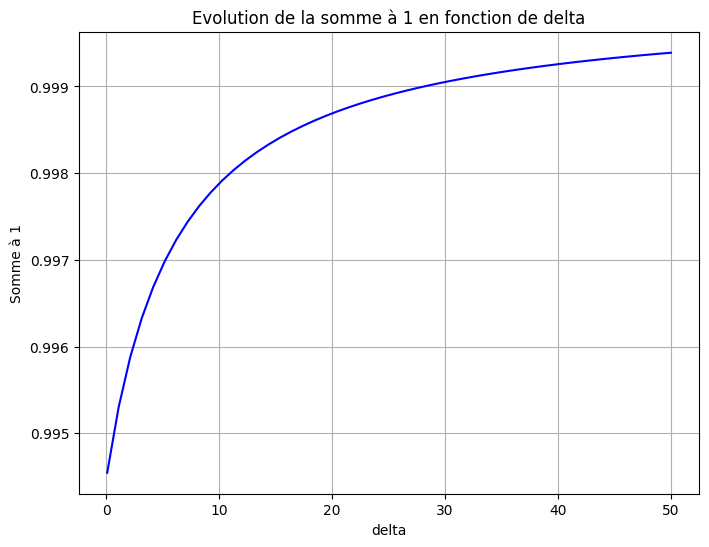

In [51]:
# TODO
sol, _ = sp.optimize.nnls(E_pr(delta=1), x_pr(x=x, delta=1))
print(np.sum(sol))

deltas = np.linspace(0.1, 50.0)

sums = []

for delta in deltas:
    asc = sp.optimize.nnls(E_pr(delta=delta), x_pr(x=x, delta=delta))
    solution, _ = asc
    sum_solution = np.sum(solution)
    sums.append(sum_solution)

plt.figure(figsize=(8, 6))
plt.plot(deltas, sums, color='blue')
plt.xlabel('delta')
plt.ylabel('Somme à 1')
plt.title('Evolution de la somme à 1 en fonction de delta')
plt.grid(True)
plt.show()

On va maintenant essayer d'optimiser la valeur de $\delta$ pour que l'ASC soit respectée "au mieux" (pas de souci à avoir en ce qui concerne l'ANC puisque (4ter) est résolu via `scipy.optimize.nnls`...)
#### 3.3) Déterminez la valeur optimale de $\delta$ de manière à ce que l'ASC soit "en moyenne" respectée à $10^{-4}$ près

Pour celà, vous pouvez :
* partir du principe que $\delta = 10^n$. Écrire $\delta$ comme une certaine puissance de 10 fonctionne bien en première approximation mais libre à vous de raffiner plus si vous le souhaitez.
* cherchez pour quelques spectres (à vous de définir combien pour que ça fasse sens) quelle puissance de $10$ pour $\delta$ permet d'obtenir une somme qui s'approche de 1 à $10^{-4}$ près.
* finalement déterminer quelle puissance de 10 pour $\delta$ fonctionne le mieux le plus souvent

On gardera cette valeur de $\delta$ pour la suite

In [52]:
# TODO
powers_of_10 = [-1, 0, 1, 2, 3, 4, 5, 6, 7]

best_delta_power = None
best_average_sum = float('inf')

for power in powers_of_10:
    delta = 10**power
    sum_errors = []

    asc = sp.optimize.nnls(E_pr(delta=delta), x_pr(x=x, delta=delta))
    solution, _ = asc
    sum_solution = np.sum(solution)
    sum_error = np.round(abs(1.0 - sum_solution),4)

    sum_errors.append(sum_error)
    average_sum_error = np.mean(sum_errors)

    if average_sum_error < best_average_sum:
        best_average_sum = average_sum_error
        best_delta_power = power

delta = 10**best_delta_power

print(f"La valeur optimale pour une somme qui s'approche de 1 à 10^-4 près est une puissance de 10^{best_delta_power}.")

La valeur optimale pour une somme qui s'approche de 1 à 10^-4 près est une puissance de 10^3.


#### 3.4) Calculez la matrice d'abondances $\boldsymbol \Phi$ pour toute l'image, puis affichez ces cartes d'abondances fractionnelles et la carte d'erreur quadratique moyenne de reconstruction pour l'image entière. Comparez avec les résultats obtenus dans les parties précédentes

In [53]:
# TODO
E_p = E_pr(delta)
x_p = x_pr(x, delta)

phi_fcls = optimize.nnls(E_p, x_p)

E_p.shape, x_p.shape, phi_fcls[0].shape

((104, 8), (104,), (8,))

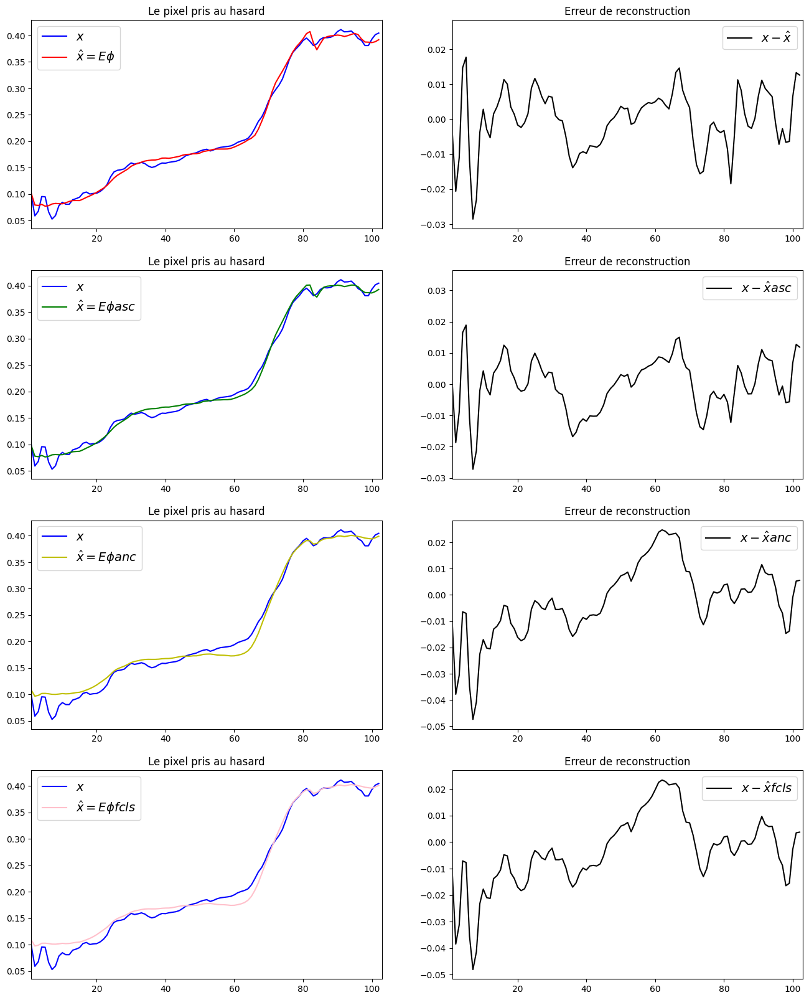

In [54]:
# TODO
plt.figure(figsize=(16,20))

plt.subplot(421)
plt.plot(x,'b',label=r'$x$')
plt.plot(E @ LSU(E,x),'r',label=r'$\hat{x} = E\phi$')
plt.title('Le pixel pris au hasard')
plt.legend(loc='best',fontsize=14)
plt.xlim((1,103))

plt.subplot(422)
plt.plot(x - E @ LSU(E,x),'k',label=r'$x - \hat{x}$')
plt.title('Erreur de reconstruction')
plt.xlim((1,103))
plt.legend(loc='best',fontsize=14)

plt.subplot(423)
plt.plot(x,'b',label=r'$x$')
plt.plot(E @ phi_asc,'g',label=r'$\hat{x} = E\phi{asc}$')
plt.title('Le pixel pris au hasard')
plt.legend(loc='best',fontsize=14)
plt.xlim((1,103))

plt.subplot(424)
plt.plot(x - E @ phi_asc,'k',label=r'$x - \hat{x}asc$')
plt.title('Erreur de reconstruction')
plt.xlim((1,103))
plt.legend(loc='best',fontsize=14)

plt.subplot(425)
plt.plot(x,'b',label=r'$x$')
plt.plot(E @ phi_anc[0],'y',label=r'$\hat{x} = E\phi{anc}$')
plt.title('Le pixel pris au hasard')
plt.legend(loc='best',fontsize=14)
plt.xlim((1,103))

plt.subplot(426)
plt.plot(x - E @ phi_anc[0],'k',label=r'$x - \hat{x}anc$')
plt.title('Erreur de reconstruction')
plt.xlim((1,103))
plt.legend(loc='best',fontsize=14)

plt.subplot(427)
plt.plot(x,'b',label=r'$x$')
plt.plot(E @ phi_fcls[0],'pink',label=r'$\hat{x} = E\phi{fcls}$')
plt.title('Le pixel pris au hasard')
plt.legend(loc='best',fontsize=14)
plt.xlim((1,103))

plt.subplot(428)
plt.plot(x - E @ phi_fcls[0],'k',label=r'$x - \hat{x}fcls$')
plt.title('Erreur de reconstruction')
plt.xlim((1,103))
plt.legend(loc='best',fontsize=14)

plt.show()

In [55]:
squared_errors_mco = (x - E @ LSU(E, x)) ** 2
rmse_mco = np.sqrt(np.mean(squared_errors_mco))

squared_errors_asc = (x - E @ phi_asc) ** 2
rmse_asc = np.sqrt(np.mean(squared_errors_asc)) # rmse = root_mean_squared_error

squared_errors_anc = (x - E @ phi_anc[0]) ** 2
rmse_anc = np.sqrt(np.mean(squared_errors_anc))

squared_errors_fcls = (x - E @ phi_fcls[0]) ** 2
rmse_fcls = np.sqrt(np.mean(squared_errors_fcls))

rmse_mco, rmse_asc, rmse_anc, rmse_fcls

# On peut en conclure que la solution trouvée par fcls est bien optimale mais un peu moins précise que celle trouvée par les autres méthodes, 
# comportement prévisible étant que les contraintes rajoutent une difficulté supplémentaire pour trouver la solution la plus optimale possible

(0.008897869531782595,
 0.009163215006380314,
 0.014113024228399476,
 0.014177622044612936)

In [56]:
# TODO
def find_fcls(E_p, x, delta) :
    x_p = x_pr(x, delta)
    phi_fcls_ = optimize.nnls(E_p, x_p)
    
    return phi_fcls_[0]

In [57]:
Phi_MCO = LSU(E, hsir.T)

Phi_MCO = Phi_MCO.reshape(m,Nrow,Ncol) # reshape en un cube 3D m x Nrow x Ncol
Phi_MCO = np.moveaxis(Phi_MCO,0,-1) # reshape finalement en un cube 3d Nrow x Ncol x m

Phi_ASC = []
Phi_ANC = []
Phi_FCLS = []

for i in range(hsir.shape[0]) :
    x_ = hsir[i, :]
    
    phi_asc_ = find_asc(E, x_)
    phi_anc_ = find_anc(E, x_)
    phi_fcls_ = find_fcls(E_p, x_, delta)
    
    Phi_ASC.append(phi_asc_)
    Phi_ANC.append(phi_anc_)
    Phi_FCLS.append(phi_fcls_)

Phi_ASC = np.array(Phi_ASC).reshape((Nrow, Ncol, m))
Phi_ANC = np.array(Phi_ANC).reshape((Nrow, Ncol, m))
Phi_FCLS = np.array(Phi_FCLS).reshape((Nrow, Ncol, m))

Phi_MCO.shape, Phi_ASC.shape, Phi_ANC.shape, Phi_FCLS.shape

((610, 340, 8), (610, 340, 8), (610, 340, 8), (610, 340, 8))

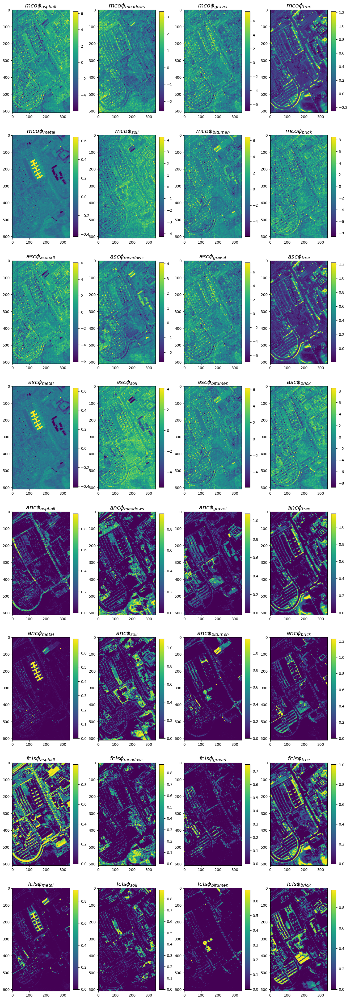

In [58]:
perc=1 # =1 si on veut filtrer un peu, =0 sinon
plow_MCO, phigh_MCO = np.percentile(Phi_MCO, (perc, 100-perc),axis=(0,1))
plow_ASC, phigh_ASC = np.percentile(Phi_ASC, (perc, 100-perc),axis=(0,1))
plow_ANC, phigh_ANC = np.percentile(Phi_ANC, (perc, 100-perc),axis=(0,1))
plow_FCLS, phigh_FCLS = np.percentile(Phi_FCLS, (perc, 100-perc),axis=(0,1))
plt.figure(figsize=(16,48))
plt.tight_layout()
for i in range(32):
    if (i < 8) :
        plt.subplot(8,4,i+1)
        plt.imshow(Phi_MCO[:,:,i], vmin=plow_MCO[i], vmax=phigh_MCO[i])
        plt.title(r'$mco\phi_{%s}$'%endmembers[i],fontsize=16)
        plt.colorbar(shrink=0.95)
    elif (i < 16) :
        plt.subplot(8,4,i+1)
        plt.imshow(Phi_ASC[:,:,i - 8], vmin=plow_ASC[i - 8], vmax=phigh_ASC[i - 8])
        plt.title(r'$asc\phi_{%s}$'%endmembers[i - 8],fontsize=16)
        plt.colorbar(shrink=0.95)
    elif (i < 24) :
        plt.subplot(8,4,i+1)
        plt.imshow(Phi_ANC[:,:,i - 16], vmin=plow_ANC[i - 16], vmax=phigh_ANC[i - 16])
        plt.title(r'$anc\phi_{%s}$'%endmembers[i - 16],fontsize=16)
        plt.colorbar(shrink=0.95)
    else :
        plt.subplot(8,4,i+1)
        plt.imshow(Phi_FCLS[:,:,i - 24], vmin=plow_FCLS[i - 24], vmax=phigh_FCLS[i - 24])
        plt.title(r'$fcls\phi_{%s}$'%endmembers[i - 24],fontsize=16)
        plt.colorbar(shrink=0.95)
plt.show()

In [59]:
eps_X_mco = LSU_MCO_results["RMSE"]

X_asc = Phi_ASC @ E.T
eps_X_asc = np.sqrt(np.mean((hsi - X_asc) ** 2, axis=2))

X_anc = Phi_ANC @ E.T
eps_X_anc = np.sqrt(np.mean((hsi - X_anc) ** 2, axis=2))

X_fcls = Phi_FCLS @ E.T
eps_X_fcls = np.sqrt(np.mean((hsi - X_fcls) ** 2, axis=2))

eps_X_mco.shape, eps_X_asc.shape, eps_X_anc.shape, eps_X_fcls.shape

((610, 340), (610, 340), (610, 340), (610, 340))

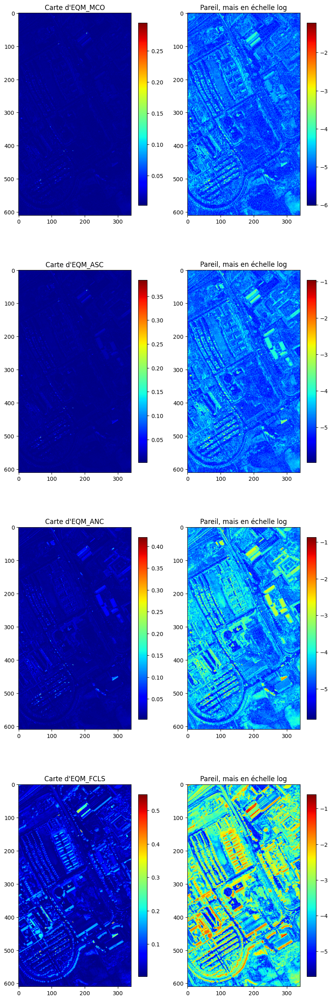

In [60]:
plt.figure(figsize=(10,32))
plt.subplot(421)
plt.title("Carte d'EQM_MCO")
plt.imshow(eps_X_mco,cmap='jet') # en échelle normale, où on ne voit pas grand chose à cause de quelques outliers
plt.colorbar(shrink=0.85)
plt.subplot(422)
plt.title('Pareil, mais en échelle log')
plt.imshow(np.log(eps_X_mco),cmap='jet') # en échelle log, on voit un peu plus la structure spatiale de l'erreur
plt.colorbar(shrink=0.85)

plt.subplot(423)
plt.title("Carte d'EQM_ASC")
plt.imshow(eps_X_asc,cmap='jet') # en échelle normale, où on ne voit pas grand chose à cause de quelques outliers
plt.colorbar(shrink=0.85)
plt.subplot(424)
plt.title('Pareil, mais en échelle log')
plt.imshow(np.log(eps_X_asc),cmap='jet') # en échelle log, on voit un peu plus la structure spatiale de l'erreur
plt.colorbar(shrink=0.85)

plt.subplot(425)
plt.title("Carte d'EQM_ANC")
plt.imshow(eps_X_anc,cmap='jet') # en échelle normale, où on ne voit pas grand chose à cause de quelques outliers
plt.colorbar(shrink=0.85)
plt.subplot(426)
plt.title('Pareil, mais en échelle log')
plt.imshow(np.log(eps_X_anc),cmap='jet') # en échelle log, on voit un peu plus la structure spatiale de l'erreur
plt.colorbar(shrink=0.85)

plt.subplot(427)
plt.title("Carte d'EQM_FCLS")
plt.imshow(eps_X_fcls,cmap='jet') # en échelle normale, où on ne voit pas grand chose à cause de quelques outliers
plt.colorbar(shrink=0.85)
plt.subplot(428)
plt.title('Pareil, mais en échelle log')
plt.imshow(np.log(eps_X_fcls),cmap='jet') # en échelle log, on voit un peu plus la structure spatiale de l'erreur
plt.colorbar(shrink=0.85)
plt.show()

#### 3.5) Réppliquez la stratégie de classification ou chaque pixel de la vérité terrain est classifié selon son abondance fractionnelle majoritaire, visualisez la carte de classification obtenue et comparez à celles des parties précédentes. Que pouvez vous en conclure ?

⚠️ Pensez toujours à exclure la classe 9 de la vérité terrain

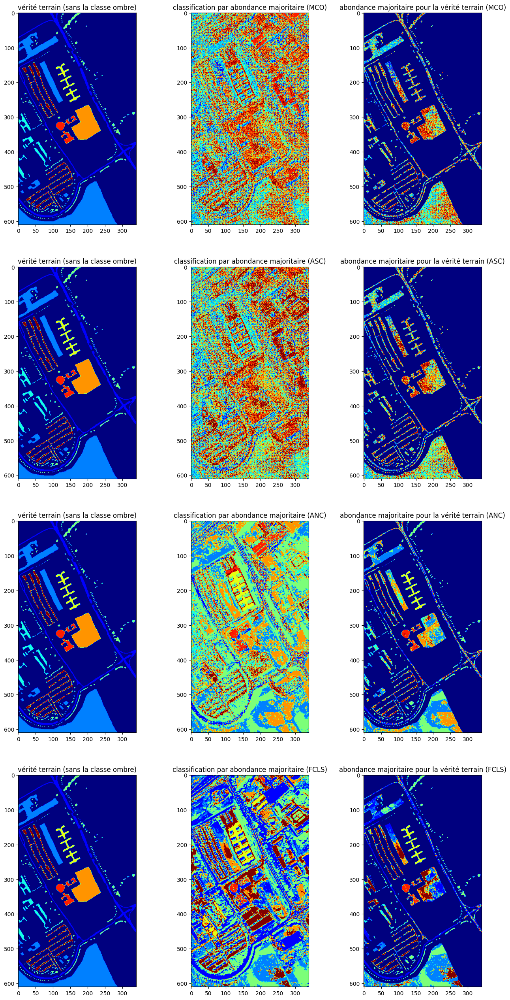

In [61]:
# TODO
new_gt = gt * (gt < 9)

argmaxPhi_ASC = np.argmax(Phi_ASC, axis=2) + 1
argmaxPhi_ASC_mask = argmaxPhi_ASC * (new_gt > 0)

argmaxPhi_ANC = np.argmax(Phi_ANC, axis=2) + 1
argmaxPhi_ANC_mask = argmaxPhi_ANC * (new_gt > 0)

argmaxPhi_FCLS = np.argmax(Phi_FCLS, axis=2) + 1
argmaxPhi_FCLS_mask = argmaxPhi_FCLS * (new_gt > 0)

argmaxPhi_MCO = LSU_MCO_results["classif_full"]
argmaxPhi_MCO_mask = LSU_MCO_results["classif_filtered"]

plt.figure(figsize=(16,32))
plt.subplot(431)
plt.title('vérité terrain (sans la classe ombre)')
plt.imshow(gt*(gt<9),cmap='jet',vmin=0,vmax=8)
plt.subplot(432)
plt.title('classification par abondance majoritaire (MCO)')
plt.imshow(argmaxPhi_MCO,cmap='jet',vmin=0,vmax=8)
plt.subplot(433)
plt.title('abondance majoritaire pour la vérité terrain (MCO)')
plt.imshow(argmaxPhi_MCO_mask,cmap='jet',vmin=0,vmax=8)

plt.subplot(434)
plt.title('vérité terrain (sans la classe ombre)')
plt.imshow(gt*(gt<9),cmap='jet',vmin=0,vmax=8)
plt.subplot(435)
plt.title('classification par abondance majoritaire (ASC)')
plt.imshow(argmaxPhi_ASC,cmap='jet',vmin=0,vmax=8)
plt.subplot(436)
plt.title('abondance majoritaire pour la vérité terrain (ASC)')
plt.imshow(argmaxPhi_ASC_mask,cmap='jet',vmin=0,vmax=8)

plt.subplot(437)
plt.title('vérité terrain (sans la classe ombre)')
plt.imshow(gt*(gt<9),cmap='jet',vmin=0,vmax=8)
plt.subplot(438)
plt.title('classification par abondance majoritaire (ANC)')
plt.imshow(argmaxPhi_ANC,cmap='jet',vmin=0,vmax=8)
plt.subplot(439)
plt.title('abondance majoritaire pour la vérité terrain (ANC)')
plt.imshow(argmaxPhi_ANC_mask,cmap='jet',vmin=0,vmax=8)

plt.subplot(4, 3, 10)
plt.title('vérité terrain (sans la classe ombre)')
plt.imshow(gt*(gt<9),cmap='jet',vmin=0,vmax=8)
plt.subplot(4, 3, 11)
plt.title('classification par abondance majoritaire (FCLS)')
plt.imshow(argmaxPhi_FCLS,cmap='jet',vmin=0,vmax=8)
plt.subplot(4, 3, 12)
plt.title('abondance majoritaire pour la vérité terrain (FCLS)')
plt.imshow(argmaxPhi_FCLS_mask,cmap='jet',vmin=0,vmax=8)
plt.show()

#### 3.6) Complétez votre analyse précédente par une évaluation quantitative : taux de bonne classification globale, matrice de confusion et taux de bonne classification par classe, et comparez aux résultats obtenus dans les parties précédentes. Que pouvez-vous conclure quant à l'utilisation des deux contraintes ANC+ASC dans la problématique de démélange avec cette optique de classification ?

In [62]:
# Taux de bonne classification globale
OA_MCO = LSU_MCO_results["overall_acc"]

new_gt_filtered = new_gt[new_gt > 0]

argmaxPhi_ASC_mask_filtered = argmaxPhi_ASC_mask[new_gt > 0]
OA_ASC_mat = (new_gt_filtered == argmaxPhi_ASC_mask_filtered)
OA_ASC = np.sum(OA_ASC_mat) / OA_ASC_mat.shape[0]

argmaxPhi_ANC_mask_filtered = argmaxPhi_ANC_mask[new_gt > 0]
OA_ANC_mat = (new_gt_filtered == argmaxPhi_ANC_mask_filtered)
OA_ANC = np.sum(OA_ANC_mat) / OA_ANC_mat.shape[0]

argmaxPhi_FCLS_mask_filtered = argmaxPhi_FCLS_mask[new_gt > 0]
OA_FCLS_mat = (new_gt_filtered == argmaxPhi_FCLS_mask_filtered)
OA_FCLS = np.sum(OA_FCLS_mat) / OA_FCLS_mat.shape[0]

print('Taux de bonne classification globale (MCO) : %1.2f%%'%(100*OA_MCO).astype(float))
print('Taux de bonne classification globale (ASC) : %1.2f%%'%(100*OA_ASC).astype(float))
print('Taux de bonne classification globale (ANC) : %1.2f%%'%(100*OA_ANC).astype(float))
print('Taux de bonne classification globale (FCLS) : %1.2f%%'%(100*OA_FCLS).astype(float))

Taux de bonne classification globale (MCO) : 28.50%
Taux de bonne classification globale (ASC) : 28.98%
Taux de bonne classification globale (ANC) : 58.60%
Taux de bonne classification globale (FCLS) : 58.26%


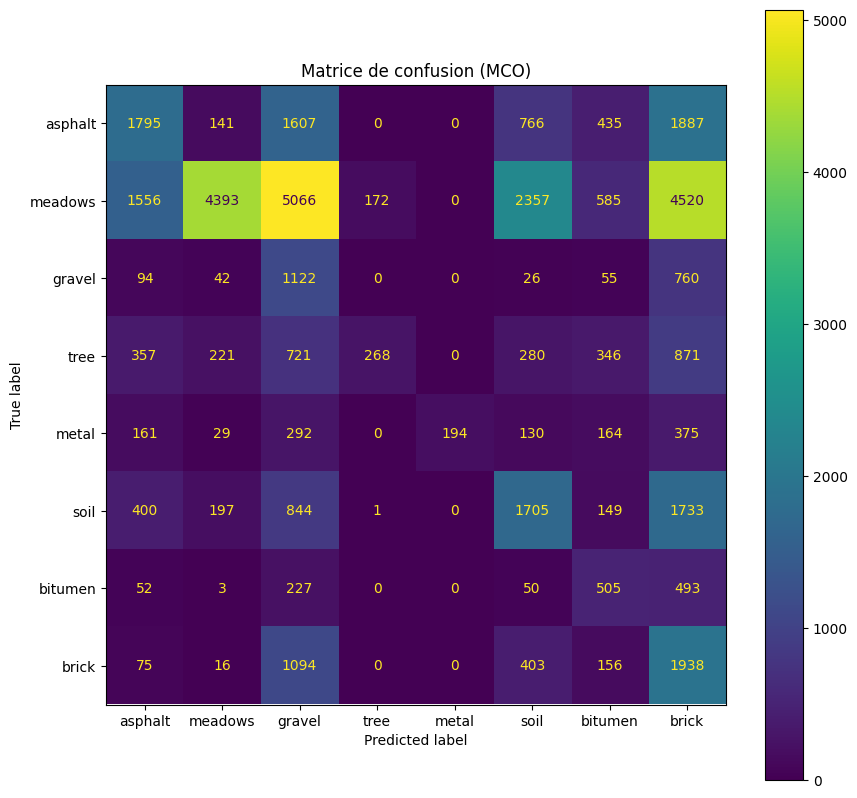

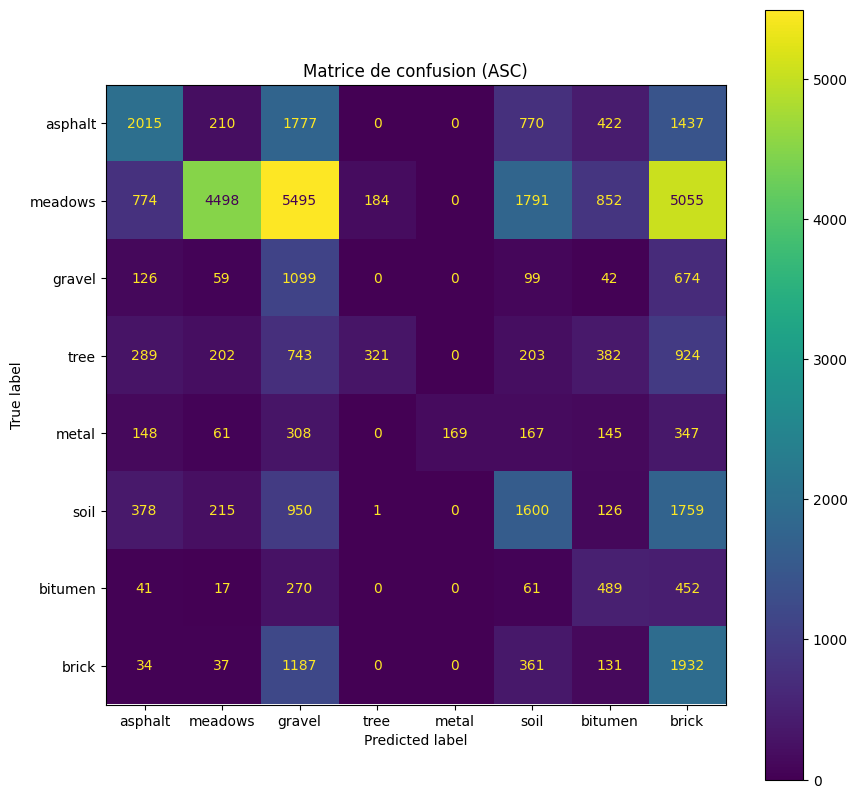

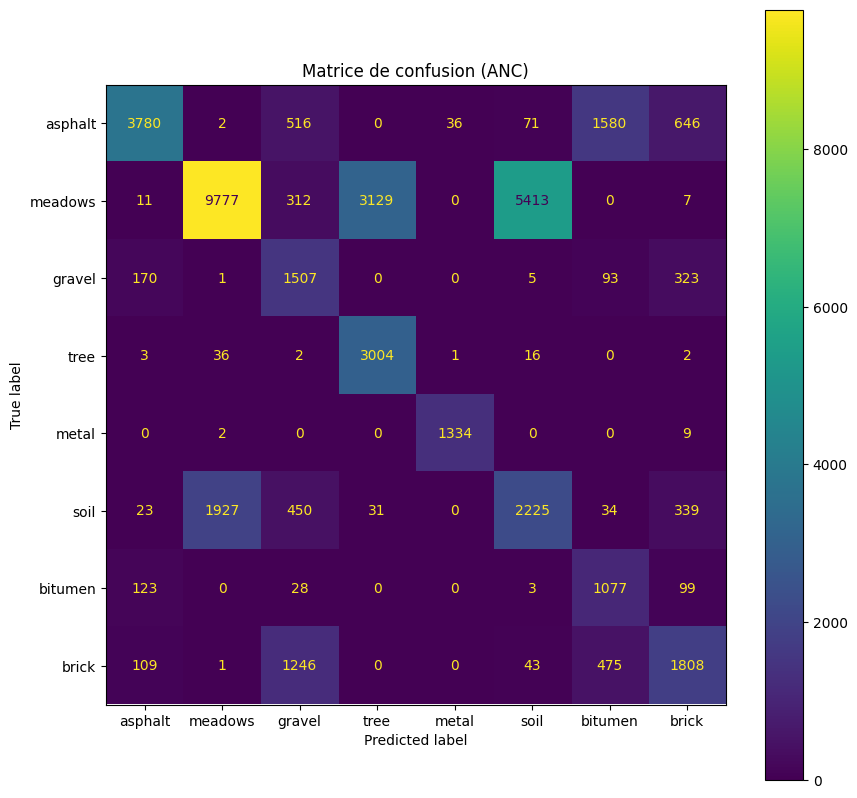

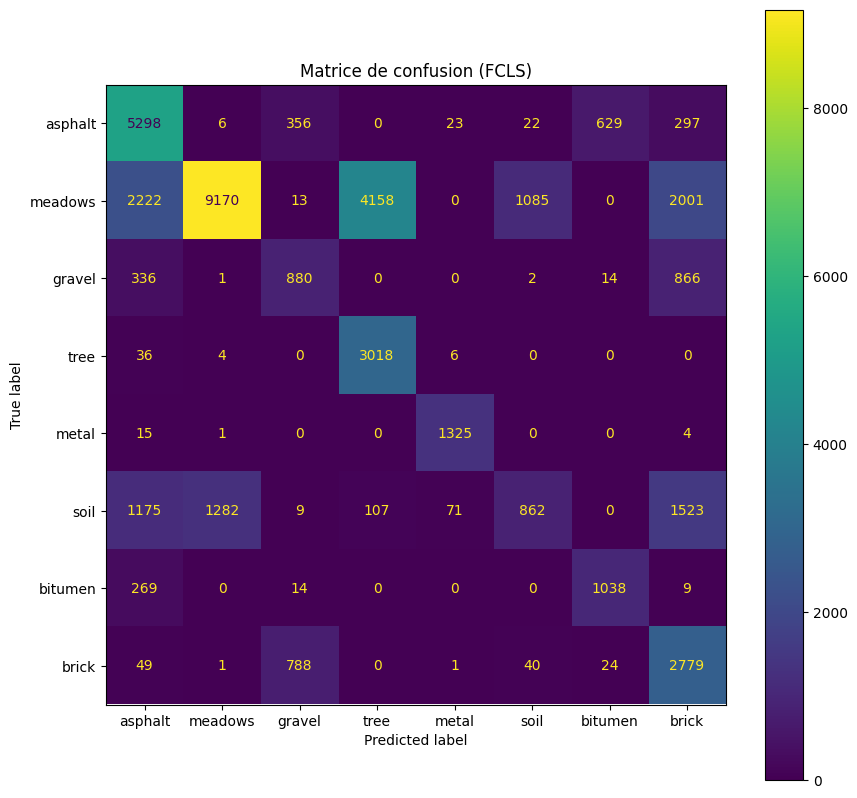

In [63]:
# Matrice de confusion
CM_ASC = sklearn.metrics.confusion_matrix(new_gt_filtered, argmaxPhi_ASC_mask_filtered)
CM_ANC = sklearn.metrics.confusion_matrix(new_gt_filtered, argmaxPhi_ANC_mask_filtered)
CM_FCLS = sklearn.metrics.confusion_matrix(new_gt_filtered, argmaxPhi_FCLS_mask_filtered)
CM_MCO = LSU_MCO_results["confusion_matrix"]

CMplot_MCO = sklearn.metrics.ConfusionMatrixDisplay(CM_MCO,display_labels=endmembers)
fig,ax = plt.subplots(figsize=(10,10))
CMplot_MCO.plot(ax=ax)
plt.title("Matrice de confusion (MCO)")
plt.show()

CMplot_ASC = sklearn.metrics.ConfusionMatrixDisplay(CM_ASC,display_labels=endmembers)
fig,ax = plt.subplots(figsize=(10,10))
CMplot_ASC.plot(ax=ax)
plt.title("Matrice de confusion (ASC)")

CMplot_ANC = sklearn.metrics.ConfusionMatrixDisplay(CM_ANC,display_labels=endmembers)
fig,ax = plt.subplots(figsize=(10,10))
CMplot_ANC.plot(ax=ax)
plt.title("Matrice de confusion (ANC)")

CMplot_FCLS = sklearn.metrics.ConfusionMatrixDisplay(CM_FCLS,display_labels=endmembers)
fig,ax = plt.subplots(figsize=(10,10))
CMplot_FCLS.plot(ax=ax)
plt.title("Matrice de confusion (FCLS)")
plt.show()

In [64]:
# Classification par classe
CA_MCO = CM_MCO.diagonal()/CM_MCO.sum(axis=1)
for i,c in enumerate(endmembers):
    print('Taux de bonne classification pour la classe (mco) %s : %1.3f%%'%(c,100*CA_MCO[i]))
    
print("\n")

CA_ASC = CM_ASC.diagonal()/CM_ASC.sum(axis=1)
for i,c in enumerate(endmembers):
    print('Taux de bonne classification pour la classe (asc) %s : %1.3f%%'%(c,100*CA_ASC[i]))

print("\n")

CA_ANC = CM_ANC.diagonal()/CM_ANC.sum(axis=1)
for i,c in enumerate(endmembers):
    print('Taux de bonne classification pour la classe (anc) %s : %1.3f%%'%(c,100*CA_ANC[i]))

print("\n")

CA_FCLS = CM_FCLS.diagonal()/CM_FCLS.sum(axis=1)
for i,c in enumerate(endmembers):
    print('Taux de bonne classification pour la classe (fcls) %s : %1.3f%%'%(c,100*CA_FCLS[i]))

Taux de bonne classification pour la classe (mco) asphalt : 27.070%
Taux de bonne classification pour la classe (mco) meadows : 23.556%
Taux de bonne classification pour la classe (mco) gravel : 53.454%
Taux de bonne classification pour la classe (mco) tree : 8.747%
Taux de bonne classification pour la classe (mco) metal : 14.424%
Taux de bonne classification pour la classe (mco) soil : 33.903%
Taux de bonne classification pour la classe (mco) bitumen : 37.970%
Taux de bonne classification pour la classe (mco) brick : 52.634%


Taux de bonne classification pour la classe (asc) asphalt : 30.388%
Taux de bonne classification pour la classe (asc) meadows : 24.119%
Taux de bonne classification pour la classe (asc) gravel : 52.358%
Taux de bonne classification pour la classe (asc) tree : 10.477%
Taux de bonne classification pour la classe (asc) metal : 12.565%
Taux de bonne classification pour la classe (asc) soil : 31.815%
Taux de bonne classification pour la classe (asc) bitumen : 36.767%

En conclusion, la contrainte par FCLS n'a pas l'air de changer significativement le taux de bonne classification globale (elle diminue par ailleurs), mais permet de mieux prédire certaines classes.

#### 3.7) Pour aller (beaucoup) plus loin : implémentez l'algorithme SUNSAL pour le démélange spectral avec ASC et ANC, et effectuez tous les benchmarks et les comparaisons qui vous paraissent judicieux avec les résultats obtenus jusqu'à maintenant

L'algorithme SUNSAL (pour <i>spectral unmixing by splitting and augmented Lagrangian</i>) permet de résoudre le problème (4bis) (et non le problème (4ter) comme jusqu'à présent) via la méthode ADMM (<i>alternating direction method of multipliers</i>)

La description mathématique de l'algorithme ainsi que son pseudo-code sont disponibles dans le papier de Bioucas-Dias et Figueiredo : [<i>Alternating direction algorithms for constrained sparse regression: Application to hyperspectral unmixing</i>](http://www.lx.it.pt/~bioucas/files/whispers10_c_sunsal.pdf)

In [65]:
# TODO (si vous avez la motivation)